In [1]:
import os
import sys
import json
import argparse

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import nibabel as nib
import seaborn as sns

from glob import glob
from nilearn.glm.second_level import SecondLevelModel
from nilearn.glm.second_level import make_second_level_design_matrix
from nilearn.image import threshold_img
from nilearn.glm import threshold_stats_img

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/nilearn/glm/__init__.py:55: FutureWarning: The nilearn.glm module is experimental. It may change in any future release of Nilearn.
  warn('The nilearn.glm module is experimental. '


In [2]:
from nilearn.masking import apply_mask
from scipy import stats

In [3]:
from nilearn import plotting, datasets, surface

# for plotting slices
mni152_template = datasets.load_mni152_template(resolution=1)
# for plotting on surface
fsaverage = datasets.fetch_surf_fsaverage('fsaverage')

In [4]:
task_label = 'tonecat'
contrast_label= 'fb-correct-vs-wrong' #'fb'
fwhm = 0.00
space_label = 'MNI152NLin2009cAsym'

# define data directories
bidsroot = os.path.join('/bgfs/bchandrasekaran/krs228/data/', 
                        'FLT/',
                        'data_denoised', #'data_bids'
                       )
nilearn_dir = os.path.join(bidsroot, 'derivatives', 'nilearn')
masks_dir = os.path.join('/bgfs/bchandrasekaran/krs228/data/', 
                         'FLT/', 'data_bids', 'derivatives', 'nilearn', 'masks')
# define first-level directory where group-level inputs will be pulled from
l1_dir = os.path.join(nilearn_dir, 'level-1_fwhm-%.02f'%fwhm)

# create output directory
group_out_dir = os.path.join(nilearn_dir, 'group_fwhm-%.02f'%fwhm)
if not os.path.exists(group_out_dir):
        os.makedirs(group_out_dir)

Based on [nilearn documentation](https://nilearn.github.io/stable/auto_examples/05_glm_second_level/plot_thresholding.html#statistical-testing-of-a-second-level-analysis)

### Build the group-level design matrix

#### Read the `participants.tsv` file from the BIDS root directory

In [5]:
participants_fpath = os.path.join(bidsroot, 'participants.tsv')
participants_df = pd.read_csv(participants_fpath, sep='\t')

# subjects to ignore (not fully processed, etc.)
ignore_subs = ['sub-FLT27', # always leave out FLT27 – did not participate
               'sub-FLT07', # bad QA 11/14/23
               #'sub-FLT05', 
               #'sub-FLT08', 'sub-FLT10', 'sub-FLT15', 'sub-FLT18', 'sub-FLT19', 
               #'sub-FLT21', 'sub-FLT22', 'sub-FLT23', 'sub-FLT24', 'sub-FLT16', 
               #'sub-FLT02', 'sub-FLT04', 'sub-FLT18', 'sub-FLT19', # currently reprocessing
              ]
participants_df.drop(participants_df[participants_df.participant_id.isin(ignore_subs)].index, inplace=True)

# re-sort by participant ID
participants_df.sort_values(by=['participant_id'], ignore_index=True, inplace=True)

In [6]:
print(participants_df)

   participant_id  age sex         group  FFR_id
0       sub-FLT02   21   F  non-Mandarin  1002.0
1       sub-FLT03   25   F      Mandarin  2002.0
2       sub-FLT04   21   F  non-Mandarin  1003.0
3       sub-FLT05   26   M      Mandarin  3010.0
4       sub-FLT06   21   F  non-Mandarin  3001.0
5       sub-FLT08   23   F      Mandarin  2005.0
6       sub-FLT09   30   F  non-Mandarin  3002.0
7       sub-FLT10   23   F      Mandarin  2006.0
8       sub-FLT11   20   F  non-Mandarin  1005.0
9       sub-FLT12   20   F  non-Mandarin  3004.0
10      sub-FLT13   23   F  non-Mandarin  3005.0
11      sub-FLT14   23   M  non-Mandarin  3006.0
12      sub-FLT15   22   M      Mandarin  2010.0
13      sub-FLT17   29   F      Mandarin     NaN
14      sub-FLT18   24   M      Mandarin  2016.0
15      sub-FLT19   24   M      Mandarin  2018.0
16      sub-FLT20   26   F  non-Mandarin  3008.0
17      sub-FLT21   21   M      Mandarin  2011.0
18      sub-FLT22   41   F      Mandarin  2017.0
19      sub-FLT23   

In [7]:
nman_df = participants_df[participants_df.group=='non-Mandarin'].reset_index(drop=True)

In [8]:
nman_df

,participant_id,age,sex,group,FFR_id
0,sub-FLT02,21,F,non-Mandarin,1002.0
1,sub-FLT04,21,F,non-Mandarin,1003.0
2,sub-FLT06,21,F,non-Mandarin,3001.0
3,sub-FLT09,30,F,non-Mandarin,3002.0
4,sub-FLT11,20,F,non-Mandarin,1005.0
5,sub-FLT12,20,F,non-Mandarin,3004.0
6,sub-FLT13,23,F,non-Mandarin,3005.0
7,sub-FLT14,23,M,non-Mandarin,3006.0
8,sub-FLT20,26,F,non-Mandarin,3008.0
9,sub-FLT25,19,F,non-Mandarin,1013.0


In [9]:
# create group-specific lists of subject IDs
sub_list_mand = list(participants_df.participant_id[participants_df.group=='Mandarin'])
sub_list_nman = list(participants_df.participant_id[participants_df.group=='non-Mandarin'])

In [10]:
print(sub_list_mand)

['sub-FLT03', 'sub-FLT05', 'sub-FLT08', 'sub-FLT10', 'sub-FLT15', 'sub-FLT17', 'sub-FLT18', 'sub-FLT19', 'sub-FLT21', 'sub-FLT22', 'sub-FLT23', 'sub-FLT24', 'sub-FLT26']


In [11]:
print(sub_list_nman)

['sub-FLT02', 'sub-FLT04', 'sub-FLT06', 'sub-FLT09', 'sub-FLT11', 'sub-FLT12', 'sub-FLT13', 'sub-FLT14', 'sub-FLT20', 'sub-FLT25', 'sub-FLT28', 'sub-FLT30']


#### Create design matrixes

In [12]:
# get participant IDs and their group labels
subjects_label = list(participants_df.participant_id)
groups_label = list(participants_df.group)

# make new dataframe from the group labels
design_mat_groupdiff = pd.DataFrame({'Mand': groups_label,
                                     'NMan': groups_label,
                                    }
                                   )
# convert to 1s and 0s for each group as appropriate
design_mat_groupdiff['Mand'].loc[design_mat_groupdiff['Mand'] == 'Mandarin'] = 1
design_mat_groupdiff['Mand'].loc[design_mat_groupdiff['Mand'] == 'non-Mandarin'] = 0
design_mat_groupdiff['NMan'].loc[design_mat_groupdiff['NMan'] == 'Mandarin'] = 0
design_mat_groupdiff['NMan'].loc[design_mat_groupdiff['NMan'] == 'non-Mandarin'] = 1
design_mat_groupdiff = design_mat_groupdiff.astype('int')
print(design_mat_groupdiff)

    Mand  NMan
0      0     1
1      1     0
2      0     1
3      1     0
4      0     1
5      1     0
6      0     1
7      1     0
8      0     1
9      0     1
10     0     1
11     0     1
12     1     0
13     1     0
14     1     0
15     1     0
16     0     1
17     1     0
18     1     0
19     1     0
20     1     0
21     0     1
22     1     0
23     0     1
24     0     1


### Define regions

In [13]:
## define ROIs
network_name = 'tian_subcortical_S3' # 'tian_subcortical_S3' # auditory

if network_name == 'auditory':
    roi_list_ordered = [
                'L-IC', 'L-MGN', 'L-HG', 'L-PT',  'L-PP', 'L-STGp', 'L-STGa', 'L-ParsOp', 'L-ParsTri',
                'R-IC', 'R-MGN', 'R-HG', 'R-PT',  'R-PP', 'R-STGp', 'R-STGa', 'R-ParsOp', 'R-ParsTri', 
               ]
elif network_name == 'aud-striatal':
    roi_list_ordered = ['L-Caud', 'L-Put', 'L-IC', 'L-MGN',
                'L-HG', 'L-PP', 'L-PT', 'L-STGa', 'L-STGp', 
                'L-ParsOp', 'L-ParsTri',
                'R-Caud', 'R-Put','R-IC', 'R-MGN',
                'R-HG', 'R-PP', 'R-PT', 'R-STGa', 'R-STGp', 
                'R-ParsOp', 'R-ParsTri',
               ]
elif network_name == 'tian_subcortical_S3':
    roi_list_ordered = [
        'CAU-DA-lh', 'CAU-DA-rh', 
        'CAU-VA-lh', 'CAU-VA-rh', 
        'pCAU-lh', 'pCAU-rh', 
        'PUT-DA-lh', 'PUT-DA-rh', 
        'PUT-DP-lh', 'PUT-DP-rh', 
        'PUT-VA-lh', 'PUT-VA-rh', 
        'PUT-VP-lh', 'PUT-VP-rh',
        'NAc-core-lh',  'NAc-core-rh', 
        'NAc-shell-lh', 'NAc-shell-rh', 
         #'aGP-lh', 'pGP-lh', 
         #'aGP-rh', 'pGP-rh',         
               ]
    


In [14]:
region_list = roi_list_ordered
print(region_list)

['CAU-DA-lh', 'CAU-DA-rh', 'CAU-VA-lh', 'CAU-VA-rh', 'pCAU-lh', 'pCAU-rh', 'PUT-DA-lh', 'PUT-DA-rh', 'PUT-DP-lh', 'PUT-DP-rh', 'PUT-VA-lh', 'PUT-VA-rh', 'PUT-VP-lh', 'PUT-VP-rh', 'NAc-core-lh', 'NAc-core-rh', 'NAc-shell-lh', 'NAc-shell-rh']


# Across all runs

### Get files

In [15]:
l1_fnames_nman = [sorted(glob(l1_dir+'/%s_space-%s/run-all/*%s_map-beta.nii.gz'%(sub_id, space_label, contrast_label)))[0] for sub_id in sub_list_nman]

In [16]:
l1_fnames_nman

['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT02_space-MNI152NLin2009cAsym/run-all/sub-FLT02_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-fb-correct-vs-wrong_map-beta.nii.gz',
 '/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT04_space-MNI152NLin2009cAsym/run-all/sub-FLT04_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-fb-correct-vs-wrong_map-beta.nii.gz',
 '/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT06_space-MNI152NLin2009cAsym/run-all/sub-FLT06_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-fb-correct-vs-wrong_map-beta.nii.gz',
 '/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT09_space-MNI152NLin2009cAsym/run-all/sub-FLT09_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-fb-correct-vs-wrong_map-beta.nii.gz',
 '/bgfs/bchandrasekaran/krs228/d

In [17]:
len(l1_fnames_nman)

12

In [18]:
nman_df

,participant_id,age,sex,group,FFR_id
0,sub-FLT02,21,F,non-Mandarin,1002.0
1,sub-FLT04,21,F,non-Mandarin,1003.0
2,sub-FLT06,21,F,non-Mandarin,3001.0
3,sub-FLT09,30,F,non-Mandarin,3002.0
4,sub-FLT11,20,F,non-Mandarin,1005.0
5,sub-FLT12,20,F,non-Mandarin,3004.0
6,sub-FLT13,23,F,non-Mandarin,3005.0
7,sub-FLT14,23,M,non-Mandarin,3006.0
8,sub-FLT20,26,F,non-Mandarin,3008.0
9,sub-FLT25,19,F,non-Mandarin,1013.0


## Mask stat maps

In [19]:
roi_mean_dict = {}
for rx, region in enumerate(roi_list_ordered):
    print(region)
    roi_mean_list = []
    
    for fx, stat_fpath in enumerate(l1_fnames_nman):
        sub_id = sub_list_nman[fx]
        mask_fpath = glob(masks_dir + f'/{sub_id}/space-MNI152NLin2009cAsym/masks-*/*{region}*.nii.gz')[0]
        
        masked_data = apply_mask(stat_fpath, mask_fpath)
        roi_mean_sub = masked_data.mean()
        
        roi_mean_list.append(roi_mean_sub)
        
    roi_mean_dict[region] = roi_mean_list

CAU-DA-lh
CAU-DA-rh
CAU-VA-lh
CAU-VA-rh
pCAU-lh
pCAU-rh
PUT-DA-lh
PUT-DA-rh
PUT-DP-lh
PUT-DP-rh
PUT-VA-lh
PUT-VA-rh
PUT-VP-lh
PUT-VP-rh
NAc-core-lh
NAc-core-rh
NAc-shell-lh
NAc-shell-rh


In [20]:
mask_path_list = []
for rx, region in enumerate(roi_list_ordered):
    print(region)
    
    sub_id = subjects_label[fx]
    mask_fpath = glob(masks_dir + f'/{sub_id}/space-MNI152NLin2009cAsym/masks-*/*{region}*.nii.gz')[0]

    # create list of mask file paths
    mask_path_list.append(mask_fpath)

CAU-DA-lh
CAU-DA-rh
CAU-VA-lh
CAU-VA-rh
pCAU-lh
pCAU-rh
PUT-DA-lh
PUT-DA-rh
PUT-DP-lh
PUT-DP-rh
PUT-VA-lh
PUT-VA-rh
PUT-VP-lh
PUT-VP-rh
NAc-core-lh
NAc-core-rh
NAc-shell-lh
NAc-shell-rh


In [21]:
roi_df = pd.DataFrame.from_dict(roi_mean_dict)

roi_df['participant_id'] = nman_df.participant_id
roi_df['participant_group'] = nman_df.group

In [22]:
roi_df

,CAU-DA-lh,CAU-DA-rh,CAU-VA-lh,CAU-VA-rh,pCAU-lh,pCAU-rh,PUT-DA-lh,PUT-DA-rh,PUT-DP-lh,PUT-DP-rh,PUT-VA-lh,PUT-VA-rh,PUT-VP-lh,PUT-VP-rh,NAc-core-lh,NAc-core-rh,NAc-shell-lh,NAc-shell-rh,participant_id,participant_group
0,-0.019398,-1.215500,-0.654601,-2.892211,-1.005346,-1.169048,0.703257,0.873369,0.871735,1.109415,1.788382,0.430575,-0.456268,0.240102,1.794319,0.497840,0.648234,1.615560,sub-FLT02,non-Mandarin
1,1.289951,1.016806,1.122681,1.574230,-0.213938,0.148842,0.512480,0.678115,0.561130,0.620533,1.187271,1.408081,0.681826,1.117066,0.855264,1.201938,1.705843,1.429624,sub-FLT04,non-Mandarin
2,0.243475,0.116999,-0.239911,0.447054,0.576441,0.744852,0.185511,0.009129,0.075252,-0.069954,0.656767,0.247369,0.434203,0.737407,0.466255,0.231868,0.314268,0.384237,sub-FLT06,non-Mandarin
3,0.679382,0.416509,0.345507,0.131590,0.967470,0.780436,0.438932,0.370094,-0.115934,0.338364,0.626248,0.838333,-0.020200,-0.161314,0.616452,0.441974,1.408808,0.550865,sub-FLT09,non-Mandarin
4,0.477989,0.391787,1.601575,1.101467,1.680737,1.385058,1.104584,0.764082,1.013709,0.201051,1.789686,2.052532,0.936493,0.227361,1.096042,0.263309,1.664941,0.786944,sub-FLT11,non-Mandarin
5,-0.055177,-0.519440,-0.349936,-0.612304,0.269875,-1.263682,0.681257,0.194982,0.216526,0.447656,0.347172,0.469295,0.297185,0.619032,-0.303658,-0.073996,0.293377,-0.641633,sub-FLT12,non-Mandarin
6,0.290988,0.535347,-0.330772,0.372087,-0.057650,-0.149574,0.218282,0.106376,-0.245650,-0.477603,0.888731,1.218994,-0.093148,-0.008738,0.255926,0.740764,0.734709,1.067472,sub-FLT13,non-Mandarin
7,0.117824,-0.104617,-2.857911,-0.407689,-0.036121,-0.191427,0.219845,0.764882,-0.409015,-0.014572,0.809320,0.791247,-0.469567,0.196157,-0.832465,-0.291457,-0.251621,-0.504178,sub-FLT14,non-Mandarin
8,-0.341707,-0.415546,0.508314,-0.981667,-1.368714,-1.506992,1.085001,0.788562,0.702738,0.599521,1.245335,0.740713,1.063137,1.106144,0.443455,0.346819,0.623975,0.684495,sub-FLT20,non-Mandarin
9,-0.027480,0.043932,0.176022,0.391932,-0.698213,-1.059823,-0.321563,-0.314969,-0.667066,-1.009239,0.492857,0.672953,-0.331022,-0.583535,0.974241,1.071564,0.923132,0.833710,sub-FLT25,non-Mandarin


In [23]:
roi_df_long = roi_df.melt(id_vars=["participant_id", "participant_group"], 
                          var_name="region", value_name="beta")

In [24]:
roi_df_long

,participant_id,participant_group,region,beta
0,sub-FLT02,non-Mandarin,CAU-DA-lh,-0.019398
1,sub-FLT04,non-Mandarin,CAU-DA-lh,1.289951
2,sub-FLT06,non-Mandarin,CAU-DA-lh,0.243475
3,sub-FLT09,non-Mandarin,CAU-DA-lh,0.679382
4,sub-FLT11,non-Mandarin,CAU-DA-lh,0.477989
...,...,...,...,...
211,sub-FLT14,non-Mandarin,NAc-shell-rh,-0.504178
212,sub-FLT20,non-Mandarin,NAc-shell-rh,0.684495
213,sub-FLT25,non-Mandarin,NAc-shell-rh,0.833710
214,sub-FLT28,non-Mandarin,NAc-shell-rh,0.998956


### split hemisphere into its own column

In [25]:
if network_name == 'auditory':
    roi_df_long['hemisphere'] = roi_df_long.region.str[0]
    roi_df_long['region'] = roi_df_long.region.str[2:]
elif network_name == 'tian_subcortical_S3':
    roi_df_long['hemisphere'] = roi_df_long.region.str[-2:]
    roi_df_long['region'] = roi_df_long.region.str[:-3]

In [26]:
roi_df_long

,participant_id,participant_group,region,beta,hemisphere
0,sub-FLT02,non-Mandarin,CAU-DA,-0.019398,lh
1,sub-FLT04,non-Mandarin,CAU-DA,1.289951,lh
2,sub-FLT06,non-Mandarin,CAU-DA,0.243475,lh
3,sub-FLT09,non-Mandarin,CAU-DA,0.679382,lh
4,sub-FLT11,non-Mandarin,CAU-DA,0.477989,lh
...,...,...,...,...,...
211,sub-FLT14,non-Mandarin,NAc-shell,-0.504178,rh
212,sub-FLT20,non-Mandarin,NAc-shell,0.684495,rh
213,sub-FLT25,non-Mandarin,NAc-shell,0.833710,rh
214,sub-FLT28,non-Mandarin,NAc-shell,0.998956,rh


### Statistics

#### Within-group significance, combining hemispheres

In [27]:
for group in np.unique(roi_df.participant_group):
    p_vals = []
    t_stats = []
    print(f'\ngroup = {group}')
    print('\nFDR-adjusted statistics')
    for roi in np.unique(roi_df_long.region):
        groi_data = roi_df_long.where(roi_df_long.region==roi).dropna().beta
        res = stats.ttest_1samp(groi_data, popmean=0)
        #print(f't = {res.statistic:.02f} p = {res.pvalue:.04f} region = {roi}')
        p_vals.append(res.pvalue)
        t_stats.append(res.statistic)
    p_vals_adj = stats.false_discovery_control(p_vals)
    for rx, roi in enumerate(np.unique(roi_df_long.region)):
        if p_vals_adj[rx] < 0.05:
            ast = '**'
        elif p_vals[rx] < 0.05:
            ast = ' *'
        else:
            ast = '  '
        print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')


group = non-Mandarin

FDR-adjusted statistics
  t = 1.76 FDR-corr p = 0.1382 uncorr p = 0.0921 region = CAU-DA
  t = -0.18 FDR-corr p = 0.8619 uncorr p = 0.8619 region = CAU-VA
**t = 4.46 FDR-corr p = 0.0004 uncorr p = 0.0002 region = NAc-core
**t = 5.72 FDR-corr p = 0.0000 uncorr p = 0.0000 region = NAc-shell
**t = 5.81 FDR-corr p = 0.0000 uncorr p = 0.0000 region = PUT-DA
  t = 1.10 FDR-corr p = 0.3613 uncorr p = 0.2810 region = PUT-DP
**t = 10.04 FDR-corr p = 0.0000 uncorr p = 0.0000 region = PUT-VA
**t = 2.56 FDR-corr p = 0.0315 uncorr p = 0.0175 region = PUT-VP
  t = -0.28 FDR-corr p = 0.8619 uncorr p = 0.7837 region = pCAU


#### Per-hemisphere within-group significance

In [28]:
for group in np.unique(roi_df.participant_group):
    p_vals = []
    t_stats = []
    print(f'\ngroup = {group}')
    print('\nFDR-adjusted statistics')
    for roi in region_list:
        groi_data = roi_df.where(roi_df.participant_group==group).dropna()[roi]
        res = stats.ttest_1samp(groi_data, popmean=0)
        #print(f't = {res.statistic:.02f} p = {res.pvalue:.04f} region = {roi}')
        p_vals.append(res.pvalue)
        t_stats.append(res.statistic)
    p_vals_adj = stats.false_discovery_control(p_vals)
    for rx, roi in enumerate(region_list):
        if p_vals_adj[rx] < 0.05:
            ast = '**'
        elif p_vals[rx] < 0.05:
            ast = ' *'
        else:
            ast = '  '
        print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')


group = non-Mandarin

FDR-adjusted statistics
 *t = 2.50 FDR-corr p = 0.0588 uncorr p = 0.0294 region = CAU-DA-lh
  t = 0.35 FDR-corr p = 0.8237 uncorr p = 0.7322 region = CAU-DA-rh
  t = -0.27 FDR-corr p = 0.8362 uncorr p = 0.7898 region = CAU-VA-lh
  t = 0.02 FDR-corr p = 0.9811 uncorr p = 0.9811 region = CAU-VA-rh
  t = 0.39 FDR-corr p = 0.8237 uncorr p = 0.7005 region = pCAU-lh
  t = -0.76 FDR-corr p = 0.6020 uncorr p = 0.4636 region = pCAU-rh
**t = 4.47 FDR-corr p = 0.0043 uncorr p = 0.0009 region = PUT-DA-lh
**t = 3.66 FDR-corr p = 0.0135 uncorr p = 0.0038 region = PUT-DA-rh
  t = 0.78 FDR-corr p = 0.6020 uncorr p = 0.4543 region = PUT-DP-lh
  t = 0.75 FDR-corr p = 0.6020 uncorr p = 0.4682 region = PUT-DP-rh
**t = 7.52 FDR-corr p = 0.0002 uncorr p = 0.0000 region = PUT-VA-lh
**t = 6.46 FDR-corr p = 0.0004 uncorr p = 0.0000 region = PUT-VA-rh
  t = 1.52 FDR-corr p = 0.2546 uncorr p = 0.1556 region = PUT-VP-lh
  t = 2.02 FDR-corr p = 0.1233 uncorr p = 0.0685 region = PUT-VP-rh
**t

### group ROI plot

/scratch/slurm-3214511/ipykernel_31205/3142408696.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=roi_df_long.where(roi_df_long.participant_group=='non-Mandarin'),
/scratch/slurm-3214511/ipykernel_31205/3142408696.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.stripplot(data=roi_df_long.where(roi_df_long.participant_group=='non-Mandarin'),
/scratch/slurm-3214511/ipykernel_31205/3142408696.py:24: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=30, ha='center')


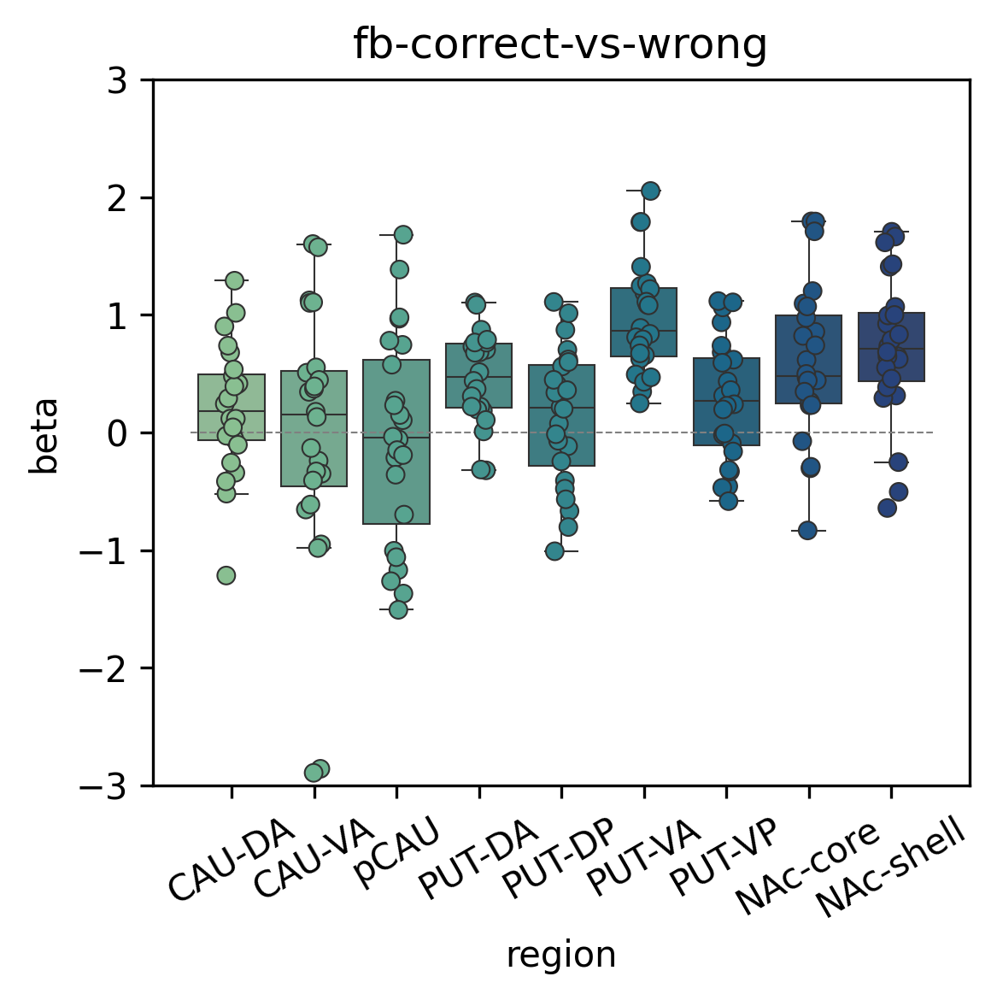

In [29]:
fig, ax = plt.subplots(1, 1, figsize=(4,4), dpi=300)
yrange = [-3, 3]

sns.boxplot(data=roi_df_long.where(roi_df_long.participant_group=='non-Mandarin'), 
              x='region', y='beta', 
              #hue='hemisphere',
              #palette=['#fdb863','#b2abd2'],
              palette='crest',
              linewidth=0.5,
              fliersize = 0,
              legend=None,
              ax=ax);
sns.stripplot(data=roi_df_long.where(roi_df_long.participant_group=='non-Mandarin'), 
              x='region', y='beta', 
              #hue='hemisphere',
              #palette=['#e66101','#5e3c99'],
              #dodge=True,
              palette='crest',
              linewidth=0.5,
              ax=ax);
xmin, xmax = ax.get_xlim()
ax.hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
ax.set_ylim(yrange)
ax.set_xticklabels(ax.get_xticklabels(), rotation=30, ha='center')
#sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
ax.set_title(f'{contrast_label}');

'''
# OUT OF DATE
# MANUAL SIGNIFICANCE MARKS (see statistics above – not ordered the same as here)
plt.text(3 -0.25, 3, '*')
plt.text(5 -0.25, 3, '*')
plt.text(10-0.25, 3, '*')
plt.text(5 +0.25, 3, '*')
'''
fig.tight_layout()


### Plot on brain

CAU-DA-lh
CAU-DA-rh
CAU-VA-lh
CAU-VA-rh
pCAU-lh
pCAU-rh
PUT-DA-lh
PUT-DA-rh
PUT-DP-lh
PUT-DP-rh
PUT-VA-lh
PUT-VA-rh
PUT-VP-lh
PUT-VP-rh
NAc-core-lh
NAc-core-rh
NAc-shell-lh
NAc-shell-rh


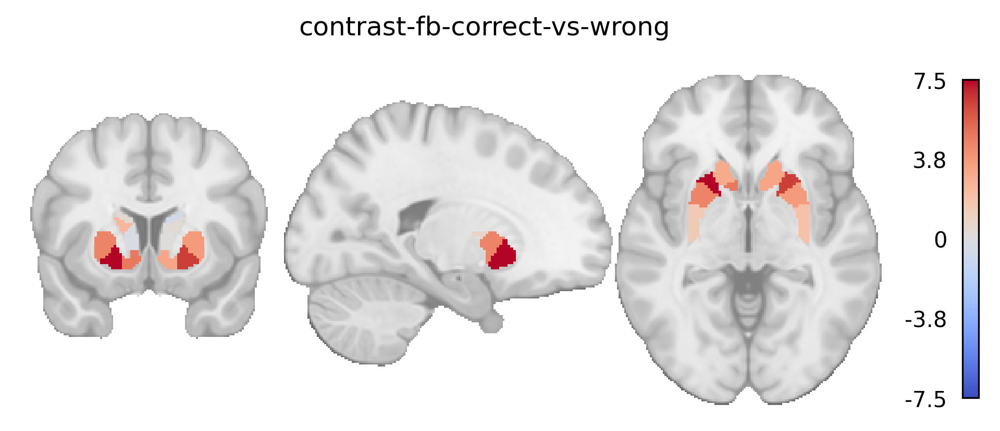

In [30]:
from nilearn.image import new_img_like
from nilearn import plotting

mask_path_list = []
for rx, region in enumerate(region_list):
    print(region)
    
    sub_id = subjects_label[fx]
    mask_fpath = glob(masks_dir + f'/{sub_id}/space-MNI152NLin2009cAsym/masks-*/*{region}*.nii.gz')[0]

    # create list of mask file paths
    mask_path_list.append(mask_fpath)

roi_stat_data_list = []
for rx, rpath in enumerate(mask_path_list):
    roi_img = nib.load(rpath)
    roi_data = roi_img.get_fdata()
    
    roi_stat = t_stats[rx]
    roi_stat_data = roi_data * roi_stat
    
    roi_stat_data_list.append(roi_stat_data)

# add maps together and make nifti img
roi_stat_map_data = sum(roi_stat_data_list)
roi_stat_map_img = new_img_like(roi_img, roi_stat_map_data)

title = f'contrast-{contrast_label}'
fig, ax = plt.subplots(figsize=(8,3), dpi=300)
plotting.plot_stat_map(roi_stat_map_img,
                       bg_img=mni152_template,
                       black_bg=False,
                       annotate=False, draw_cross=False,
                       cmap='coolwarm',
                       axes=ax)
fig.suptitle(title);

### 3D plots

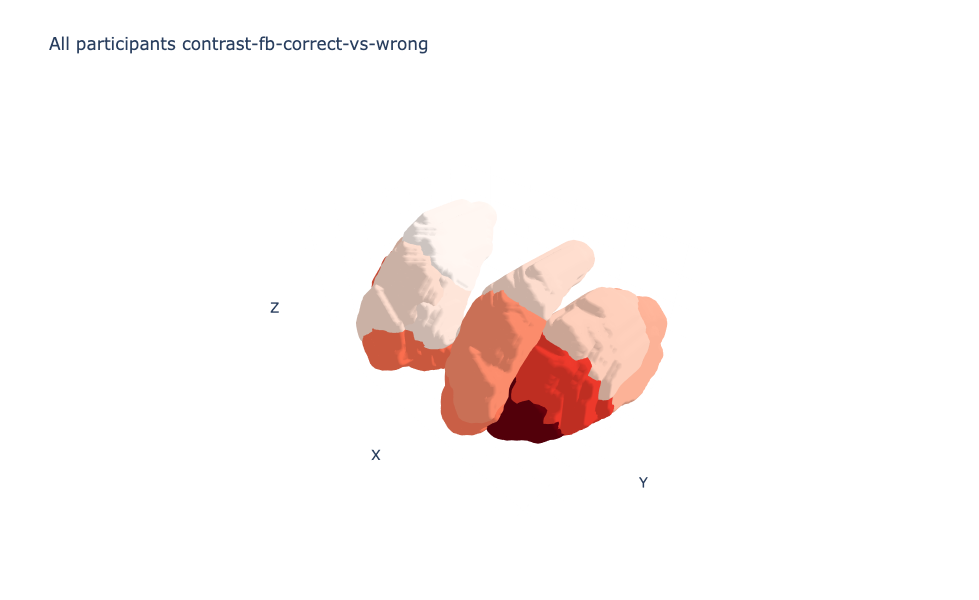

In [31]:
import numpy as np
import nibabel as nib
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from matplotlib import cm
from skimage import measure
from scipy.ndimage import gaussian_filter

# Load NIfTI files into a list
nifti_files = mask_path_list

# Define a colormap
colormap = cm.get_cmap('Reds')

# Define the list of values for color plotting
color_values = t_stats  # Adjust these values as needed

# Create a list to hold the data for each segmentation
segmentations = []

# Loop through each NIfTI file and extract segmentation data
for nifti_file in nifti_files:
    nifti_data = nib.load(nifti_file)
    segmentation = nifti_data.get_fdata()
    segmentations.append(segmentation)

# Combine all segmentations into a single binary mask
combined_segmentation = np.any(segmentations, axis=0)

# Upsample the voxel data to a higher resolution grid
upsampled_segmentation = np.repeat(np.repeat(np.repeat(combined_segmentation, 2, axis=0), 2, axis=1), 2, axis=2)

# Smooth the upsampled voxel data with a Gaussian filter
smoothed_segmentation = gaussian_filter(upsampled_segmentation, sigma=1)

# Extract the surface mesh of the smoothed segmented region with adjusted level
vertices, faces, _, _ = measure.marching_cubes(smoothed_segmentation, level=smoothed_segmentation.mean())

# Translate vertices closer to the origin
center = vertices.mean(axis=0)
vertices -= center

# Create a subplot for the 3D plot with a larger size
fig = make_subplots(rows=1, cols=1, specs=[[{'type': 'mesh3d'}]], print_grid=False)

# Loop through each segmentation and add its surface plot to the subplot
for i, segmentation in enumerate(segmentations):
    # Upsample the voxel data to a higher resolution grid
    upsampled_segmentation = np.repeat(np.repeat(np.repeat(segmentation, 2, axis=0), 2, axis=1), 2, axis=2)
    
    # Smooth the upsampled voxel data with a Gaussian filter
    smoothed_segmentation = gaussian_filter(upsampled_segmentation, sigma=1)
    
    # Extract the surface mesh of the smoothed segmented region with adjusted level
    vertices, faces, _, _ = measure.marching_cubes(smoothed_segmentation, level=smoothed_segmentation.mean())
    
    vertices -= center
    
    # Map the color value to the colormap
    colormap_value = (color_values[i] - min(color_values)) / (max(color_values) - min(color_values))
    color = colormap(colormap_value)
    
    # Add the surface plot to the subplot
    fig.add_trace(go.Mesh3d(
        x=vertices[:, 0],
        y=vertices[:, 1],
        z=vertices[:, 2],
        i=faces[:, 0],
        j=faces[:, 1],
        k=faces[:, 2],
        color=f'rgb({int(color[0]*255)}, {int(color[1]*255)}, {int(color[2]*255)})',
        opacity=1,
        name= f'{region_list[i]} t = {t_stats[i]}' # f'Segmentation {i+1}'
    ))

# Set starting camera angle
camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=-1.25, y=1.25, z=1.25)
)

# Update layout for the 3D plot to set a larger size and transparent background
fig.update_layout(
    scene=dict(
        xaxis=dict(title='X', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        yaxis=dict(title='Y', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        zaxis=dict(title='Z', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        bgcolor='rgba(0,0,0,0)',  # Set background color to transparent
        camera=camera  # Set starting camera angle
    ),
    title=f'All participants contrast-{contrast_label}',
    width=800,  # Set width of the plot
    height=600,  # Set height of the plot
)

'''
# Add XYZ axis legends closer to the surfaces
axis_length = 10  # Adjust the length of the axis lines
text_offset = 5  # Adjust the offset for text position

fig.add_trace(go.Scatter3d(
    x=[0, axis_length],
    y=[0, 0],
    z=[0, 0],
    mode='lines+text',
    line=dict(color='black', width=4),
    text=['X', ''],
    textposition='middle center',
    showlegend=False
))

fig.add_trace(go.Scatter3d(
    x=[0, 0],
    y=[0, axis_length],
    z=[0, 0],
    mode='lines+text',
    line=dict(color='black', width=4),
    text=['', 'Y'],
    textposition='middle center',
    showlegend=False
))

fig.add_trace(go.Scatter3d(
    x=[0, 0],
    y=[0, 0],
    z=[0, axis_length],
    mode='lines+text',
    line=dict(color='black', width=4),
    text=['', '', 'Z'],
    textposition='middle center',
    showlegend=False
))
'''

# Show the interactive plot
fig.show()

# Save the interactive plot as an SVG file
fig.write_image(f'out-figure_group-nman_contrast-{contrast_label}_surface.svg')

# Early vs. late runs (thirds)

In [32]:
# get the beta map for the contrast of interest for each subject
l1_fnames_third1 = [sorted(glob(l1_dir+'/%s_space-%s/grouped_runs/earlythird/*%s_map-beta.nii.gz'%(sub_id, space_label, contrast_label)))[0] for sub_id in sub_list_nman]
l1_fnames_third2 = [sorted(glob(l1_dir+'/%s_space-%s/grouped_runs/middlethird/*%s_map-beta.nii.gz'%(sub_id, space_label, contrast_label)))[0] for sub_id in sub_list_nman]
l1_fnames_third3 = [sorted(glob(l1_dir+'/%s_space-%s/grouped_runs/latethird/*%s_map-beta.nii.gz'%(sub_id, space_label, contrast_label)))[0] for sub_id in sub_list_nman]


In [33]:
l1_fnames_third1

['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT02_space-MNI152NLin2009cAsym/grouped_runs/earlythird/sub-FLT02_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-fb-correct-vs-wrong_map-beta.nii.gz',
 '/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT04_space-MNI152NLin2009cAsym/grouped_runs/earlythird/sub-FLT04_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-fb-correct-vs-wrong_map-beta.nii.gz',
 '/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT06_space-MNI152NLin2009cAsym/grouped_runs/earlythird/sub-FLT06_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-fb-correct-vs-wrong_map-beta.nii.gz',
 '/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT09_space-MNI152NLin2009cAsym/grouped_runs/earlythird/sub-FLT09_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-fb-cor

## Mask stat maps

In [34]:
roi_third1_mean_dict = {}
roi_third2_mean_dict = {}
roi_third3_mean_dict = {}
for rx, region in enumerate(region_list):
    print(region)
    
    roi_third1_mean_list = []
    for fx, stat_fpath in enumerate(l1_fnames_third1):
        sub_id = subjects_label[fx]
        mask_fpath = glob(masks_dir + f'/{sub_id}/space-MNI152NLin2009cAsym/masks-*/*{region}*.nii.gz')[0]
        
        masked_data = apply_mask(stat_fpath, mask_fpath)
        roi_mean_sub = masked_data.mean()
        
        roi_third1_mean_list.append(roi_mean_sub)
        
    roi_third1_mean_dict[region] = roi_third1_mean_list
    
    roi_third2_mean_list = []
    for fx, stat_fpath in enumerate(l1_fnames_third2):
        sub_id = subjects_label[fx]
        mask_fpath = glob(masks_dir + f'/{sub_id}/space-MNI152NLin2009cAsym/masks-*/*{region}*.nii.gz')[0]
        
        masked_data = apply_mask(stat_fpath, mask_fpath)
        roi_mean_sub = masked_data.mean()
        
        roi_third2_mean_list.append(roi_mean_sub)
        
    roi_third2_mean_dict[region] = roi_third2_mean_list
    
    roi_third3_mean_list = []
    for fx, stat_fpath in enumerate(l1_fnames_third3):
        sub_id = subjects_label[fx]
        mask_fpath = glob(masks_dir + f'/{sub_id}/space-MNI152NLin2009cAsym/masks-*/*{region}*.nii.gz')[0]
        
        masked_data = apply_mask(stat_fpath, mask_fpath)
        roi_mean_sub = masked_data.mean()
        
        roi_third3_mean_list.append(roi_mean_sub)
        
    roi_third3_mean_dict[region] = roi_third3_mean_list
    

CAU-DA-lh
CAU-DA-rh
CAU-VA-lh
CAU-VA-rh
pCAU-lh
pCAU-rh
PUT-DA-lh
PUT-DA-rh
PUT-DP-lh
PUT-DP-rh
PUT-VA-lh
PUT-VA-rh
PUT-VP-lh
PUT-VP-rh
NAc-core-lh
NAc-core-rh
NAc-shell-lh
NAc-shell-rh


In [35]:
roi_third1_df = pd.DataFrame.from_dict(roi_third1_mean_dict)
roi_third2_df = pd.DataFrame.from_dict(roi_third2_mean_dict)
roi_third3_df = pd.DataFrame.from_dict(roi_third3_mean_dict)

roi_third1_df['participant_id'] = nman_df.participant_id
roi_third1_df['participant_group'] = nman_df.group
roi_third2_df['participant_id'] = nman_df.participant_id
roi_third2_df['participant_group'] = nman_df.group
roi_third3_df['participant_id'] = nman_df.participant_id
roi_third3_df['participant_group'] = nman_df.group

In [36]:
roi_third1_df

,CAU-DA-lh,CAU-DA-rh,CAU-VA-lh,CAU-VA-rh,pCAU-lh,pCAU-rh,PUT-DA-lh,PUT-DA-rh,PUT-DP-lh,PUT-DP-rh,PUT-VA-lh,PUT-VA-rh,PUT-VP-lh,PUT-VP-rh,NAc-core-lh,NAc-core-rh,NAc-shell-lh,NAc-shell-rh,participant_id,participant_group
0,0.478166,0.421870,0.544974,0.327661,-0.893661,0.102913,0.793155,0.146438,0.558444,0.681167,2.181207,1.778827,0.219962,-0.000350,0.715854,1.368073,1.049627,2.421575,sub-FLT02,non-Mandarin
1,2.664499,2.051858,2.543233,3.512460,0.408410,0.973221,0.770260,0.352122,0.627162,0.725904,1.425733,1.741402,1.002913,2.088715,1.033232,1.704859,2.361975,2.618847,sub-FLT04,non-Mandarin
2,-0.274634,-0.219277,-0.134266,-0.057601,0.770254,0.308449,-0.324297,-0.260274,0.048200,-0.674045,0.064617,0.047349,0.528812,0.203238,-0.124850,-0.051456,0.400622,0.635242,sub-FLT06,non-Mandarin
3,1.482735,1.116209,1.208603,0.968050,1.324899,1.478946,0.605249,0.985954,-0.114140,0.383881,1.068788,2.353571,0.576332,0.802219,0.973298,1.029115,1.287795,1.577188,sub-FLT09,non-Mandarin
4,0.735745,1.370160,1.894660,2.182832,2.311965,2.054005,1.274807,0.292986,1.037756,0.310289,0.987166,0.888664,0.219935,0.245586,1.171955,1.367413,1.676484,0.509361,sub-FLT11,non-Mandarin
5,1.140066,0.665164,1.671979,1.287831,1.772673,-0.292687,1.219038,0.410553,1.349046,1.523339,1.130690,0.545716,1.437853,2.214307,0.815386,0.600186,0.637810,-0.081736,sub-FLT12,non-Mandarin
6,0.146944,0.687155,0.368512,1.347684,-0.163879,0.757022,0.075908,0.104162,-0.467134,-0.246093,0.212841,0.629465,-0.171758,0.264180,0.130618,0.808955,0.844519,1.016163,sub-FLT13,non-Mandarin
7,-0.395046,-1.448560,-1.613956,0.083766,-0.613256,-0.983734,0.186468,0.221254,0.066820,0.339462,0.155314,0.269941,0.260762,1.017935,-1.525749,-1.505710,0.444897,-0.320693,sub-FLT14,non-Mandarin
8,0.177113,0.282728,0.498598,0.207140,-0.481732,-0.466949,0.346320,0.538607,-0.019567,0.375169,1.088644,0.855211,0.724776,0.480827,0.912230,0.463196,0.738307,0.627381,sub-FLT20,non-Mandarin
9,0.355053,0.543356,0.578093,0.654216,0.239831,0.532065,0.160168,-0.124588,-0.101100,-0.442883,0.935947,0.650343,-0.136636,-0.266085,1.188562,1.307696,0.753281,0.843812,sub-FLT25,non-Mandarin


In [37]:
roi_third2_df

,CAU-DA-lh,CAU-DA-rh,CAU-VA-lh,CAU-VA-rh,pCAU-lh,pCAU-rh,PUT-DA-lh,PUT-DA-rh,PUT-DP-lh,PUT-DP-rh,PUT-VA-lh,PUT-VA-rh,PUT-VP-lh,PUT-VP-rh,NAc-core-lh,NAc-core-rh,NAc-shell-lh,NAc-shell-rh,participant_id,participant_group
0,1.276570,-1.024845,1.684727,-0.872761,-0.458690,-0.814692,1.438184,1.896558,2.126766,1.732637,2.671260,-1.182217,-0.461131,0.330360,2.921289,-1.369558,-0.636115,-0.121947,sub-FLT02,non-Mandarin
1,-0.001089,0.103316,-0.315148,-0.367390,-1.364941,-1.285281,0.208256,0.826464,0.249562,0.357192,1.127094,0.926386,0.175351,0.128029,0.317806,0.970188,1.281239,0.768002,sub-FLT04,non-Mandarin
2,-0.771356,0.041340,0.400921,1.853005,0.898014,1.297554,0.186339,-0.176197,-0.518115,-0.446324,0.758964,0.052262,-0.089877,0.437182,0.141055,0.327365,1.177122,0.980450,sub-FLT06,non-Mandarin
3,0.307345,1.346634,0.561424,0.319971,1.731504,2.212713,0.330394,-0.110855,0.081309,0.331002,0.717711,-0.029040,-0.183194,-0.188285,0.923743,0.591492,1.372238,0.171378,sub-FLT09,non-Mandarin
4,1.027571,0.532861,2.735139,1.212366,1.099385,0.623449,2.369334,1.558111,1.964343,0.913959,3.045422,2.796391,1.794263,0.899516,1.730615,0.994956,2.475228,0.880029,sub-FLT11,non-Mandarin
5,-0.605319,-1.451168,-1.028377,-1.909534,-0.661637,-2.318771,0.667241,-0.478125,-0.010833,-0.141747,-0.392491,0.068968,-0.135658,0.540188,-0.629231,-0.889511,0.730627,-0.867476,sub-FLT12,non-Mandarin
6,-0.797702,0.100562,-0.854708,-0.212685,-0.472149,-0.175929,0.055728,-0.141790,-0.226265,-0.249268,1.129515,0.958247,-0.018154,-0.060513,-0.187594,0.701215,0.500218,1.022665,sub-FLT13,non-Mandarin
7,-0.296274,-0.254236,-2.720751,-0.333690,-0.898922,-0.375843,0.604629,1.274752,0.043346,0.538511,-0.009209,0.686424,-0.753542,-0.013151,0.346465,0.331619,-0.081027,-0.703734,sub-FLT14,non-Mandarin
8,-1.594699,-0.865971,0.353912,-2.609914,-2.803403,-2.276440,1.481295,0.845678,1.233703,0.852500,1.053998,0.347224,1.397954,2.126824,0.018769,0.558663,-0.039281,0.471515,sub-FLT20,non-Mandarin
9,-0.034921,-0.069679,0.463731,0.475812,-0.437930,-0.826104,-0.339335,-0.385546,-0.625884,-1.010912,-0.004531,0.500839,0.488506,-0.507208,0.440658,0.927367,1.082240,0.021054,sub-FLT25,non-Mandarin


In [38]:
roi_third3_df

,CAU-DA-lh,CAU-DA-rh,CAU-VA-lh,CAU-VA-rh,pCAU-lh,pCAU-rh,PUT-DA-lh,PUT-DA-rh,PUT-DP-lh,PUT-DP-rh,PUT-VA-lh,PUT-VA-rh,PUT-VP-lh,PUT-VP-rh,NAc-core-lh,NAc-core-rh,NAc-shell-lh,NAc-shell-rh,participant_id,participant_group
0,-1.812931,-3.043527,-4.193505,-8.131533,-1.663686,-2.795366,-0.133047,0.608195,-0.130014,0.914441,0.607581,0.796393,-1.104706,0.390298,1.745814,1.495007,1.633285,2.339939,sub-FLT02,non-Mandarin
1,1.206442,0.895244,1.139959,1.467942,0.314717,0.758585,0.542453,0.845734,0.841136,0.814604,0.950369,1.472388,0.691410,1.091962,1.214754,0.930768,1.367389,0.876777,sub-FLT04,non-Mandarin
2,1.776415,0.528934,-1.115995,-0.726275,0.061055,0.628552,0.699264,0.475689,0.718171,0.930073,1.141111,0.659256,0.870552,1.573570,1.382560,0.413823,-0.633133,-0.476633,sub-FLT06,non-Mandarin
3,0.248064,-1.213315,-0.718964,-0.867234,-0.153991,-1.350350,0.382637,0.211692,-0.385480,0.320749,0.136464,0.217683,-0.506876,-0.953322,-0.071975,-0.294685,1.239217,0.325906,sub-FLT09,non-Mandarin
4,-0.329348,-0.727660,0.174926,-0.090797,1.630862,1.477720,-0.330389,0.441147,0.039029,-0.634783,0.927989,1.100347,0.795656,-0.467548,0.380009,-1.760272,-0.295070,-0.029823,sub-FLT11,non-Mandarin
5,-0.700279,-0.772317,-1.693411,-1.215210,-0.301411,-1.179587,0.167903,0.641135,-0.692036,-0.070475,0.303317,0.793202,-0.422035,-0.919078,-1.097128,0.067338,-0.453490,-1.006774,sub-FLT12,non-Mandarin
6,1.523722,0.818323,-0.506120,-0.018739,0.463077,-1.029816,0.526043,0.389641,-0.047422,-0.916783,1.341333,2.048951,-0.093148,-0.237266,0.824752,0.712123,0.859391,1.134436,sub-FLT13,non-Mandarin
7,1.044791,1.388945,-4.198535,-0.989808,1.403814,0.603711,0.025173,0.824215,-1.278820,-0.827656,2.317207,1.415257,-0.893568,-0.429364,-1.318112,0.270336,-1.399745,-0.817463,sub-FLT14,non-Mandarin
8,0.392464,-0.663395,0.672431,-0.542226,-0.821008,-1.777587,1.432919,0.982933,0.912344,0.545501,1.589532,1.017961,1.028253,0.707183,0.399364,0.018599,1.172898,0.954588,sub-FLT20,non-Mandarin
9,-0.402570,-0.341881,-0.513759,0.045769,-1.896539,-2.885429,-0.840144,-0.399753,-1.280811,-1.566141,0.546272,0.780297,-1.343427,-0.977312,1.293503,0.979629,0.933874,1.527994,sub-FLT25,non-Mandarin


In [39]:
roi_third1_df_long = roi_third1_df.melt(id_vars=["participant_id", "participant_group", ], 
                                              var_name="roi", value_name="beta")
roi_third1_df_long['stage'] = 'first_third'

roi_third2_df_long = roi_third2_df.melt(id_vars=["participant_id", "participant_group"], 
                                               var_name="roi", value_name="beta")
roi_third2_df_long['stage'] = 'middle_third'

roi_third3_df_long = roi_third3_df.melt(id_vars=["participant_id", "participant_group"], 
                                               var_name="roi", value_name="beta")
roi_third3_df_long['stage'] = 'last_third'

if network_name == 'auditory':
    roi_third1_df_long['hemisphere'] = roi_third1_df_long.roi.str[0]
    roi_third1_df_long['region'] = roi_third1_df_long.roi.str[2:]
    roi_third2_df_long['hemisphere'] = roi_third2_df_long.roi.str[0]
    roi_third2_df_long['region'] = roi_third2_df_long.roi.str[2:]
    roi_third3_df_long['hemisphere'] = roi_third3_df_long.roi.str[0]
    roi_third3_df_long['region'] = roi_third3_df_long.roi.str[2:]
elif network_name == 'tian_subcortical_S3':
    roi_third1_df_long['hemisphere'] = roi_third1_df_long.roi.str[-2:]
    roi_third1_df_long['region'] = roi_third1_df_long.roi.str[:-3]
    roi_third2_df_long['hemisphere'] = roi_third2_df_long.roi.str[-2:]
    roi_third2_df_long['region'] = roi_third2_df_long.roi.str[:-3]
    roi_third3_df_long['hemisphere'] = roi_third3_df_long.roi.str[-2:]
    roi_third3_df_long['region'] = roi_third3_df_long.roi.str[:-3]

In [40]:
roi_df_long = pd.concat([roi_third1_df_long, 
                         #roi_third2_df_long, 
                         roi_third3_df_long, ],)


In [41]:
roi_df_long

,participant_id,participant_group,roi,beta,stage,hemisphere,region
0,sub-FLT02,non-Mandarin,CAU-DA-lh,0.478166,first_third,lh,CAU-DA
1,sub-FLT04,non-Mandarin,CAU-DA-lh,2.664499,first_third,lh,CAU-DA
2,sub-FLT06,non-Mandarin,CAU-DA-lh,-0.274634,first_third,lh,CAU-DA
3,sub-FLT09,non-Mandarin,CAU-DA-lh,1.482735,first_third,lh,CAU-DA
4,sub-FLT11,non-Mandarin,CAU-DA-lh,0.735745,first_third,lh,CAU-DA
...,...,...,...,...,...,...,...
211,sub-FLT14,non-Mandarin,NAc-shell-rh,-0.817463,last_third,rh,NAc-shell
212,sub-FLT20,non-Mandarin,NAc-shell-rh,0.954588,last_third,rh,NAc-shell
213,sub-FLT25,non-Mandarin,NAc-shell-rh,1.527994,last_third,rh,NAc-shell
214,sub-FLT28,non-Mandarin,NAc-shell-rh,1.004961,last_third,rh,NAc-shell


### Compare thirds

/scratch/slurm-3214511/ipykernel_31205/4183355355.py:22: UserWarning:

FixedFormatter should only be used together with FixedLocator



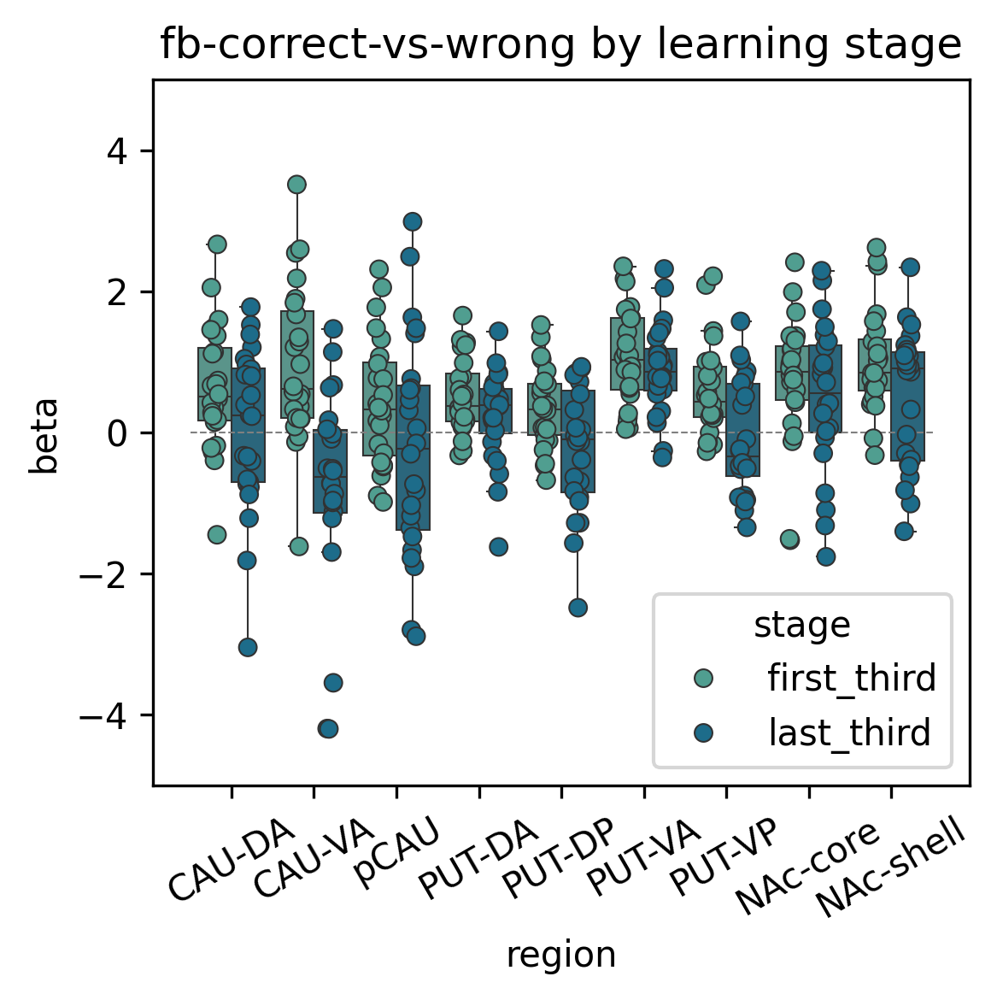

In [42]:
fig, ax = plt.subplots(1, 1, figsize=(4,4), dpi=300)

sns.boxplot(data=roi_df_long.where(roi_df_long.participant_group=='non-Mandarin'), 
              x='region', y='beta', 
              hue='stage',
              #palette=['#fdb863','#b2abd2'],
              palette='crest',
              fliersize = 0,            
              linewidth=0.5,
              legend=None,
              ax=ax);
sns.stripplot(data=roi_df_long.where(roi_df_long.participant_group=='non-Mandarin'), 
              x='region', y='beta', 
              hue='stage',
              #palette=['#e66101','#5e3c99'],
              dodge=True,
              palette='crest',
              linewidth=0.5,
              ax=ax);
xmin, xmax = ax.get_xlim()
ax.hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
ax.set_xticklabels(ax.get_xticklabels(), rotation=30, ha='center')
#sns.move_legend(ax[0], "upper left", bbox_to_anchor=(1, 1))
ax.set_title(f'{contrast_label} by learning stage');
ax.set_ylim([-5, 5])

fig.tight_layout()


/scratch/slurm-3214511/ipykernel_31205/1962822863.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/scratch/slurm-3214511/ipykernel_31205/1962822863.py:12: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/scratch/slurm-3214511/ipykernel_31205/1962822863.py:22: UserWarning:

FixedFormatter should only be used together with FixedLocator

/scratch/slurm-3214511/ipykernel_31205/1962822863.py:27: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/scratch/slurm-3214511/ipykernel_31205/1962822863.py:35: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will b

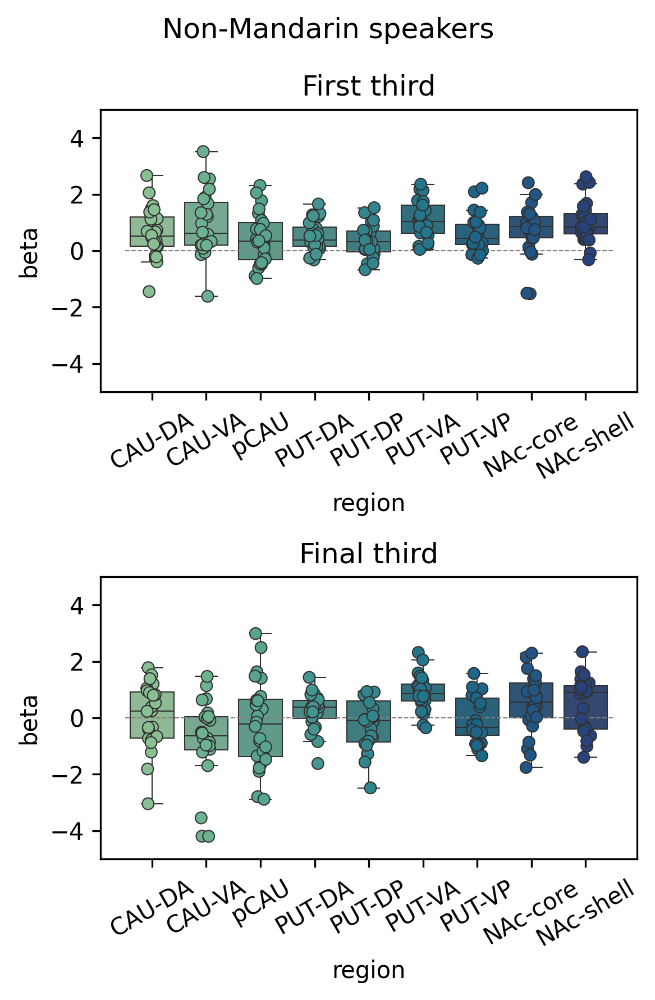

In [43]:
fig, ax = plt.subplots(2, 1, figsize=(4,6), dpi=300)
fig.suptitle('Non-Mandarin speakers')

sns.boxplot(data=roi_third1_df_long.where(roi_third1_df_long.participant_group=='non-Mandarin'), 
              x='region', y='beta', 
              #hue='hemisphere',
              #palette=['#fdb863','#b2abd2'],
              palette='crest',
              fliersize = 0,            
              linewidth=0.5,
              ax=ax[0]);
sns.stripplot(data=roi_third1_df_long.where(roi_third1_df_long.participant_group=='non-Mandarin'), 
              x='region', y='beta', 
              #hue='hemisphere',
              #palette=['#e66101','#5e3c99'],
              #dodge=True,
              palette='crest',
              linewidth=0.5,
              ax=ax[0]);
xmin, xmax = ax[0].get_xlim()
ax[0].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=30, ha='center')
#sns.move_legend(ax[0], "upper left", bbox_to_anchor=(1, 1))
ax[0].set_title('First third');
ax[0].set_ylim([-5, 5])

sns.boxplot(data=roi_third3_df_long.where(roi_third3_df_long.participant_group=='non-Mandarin'), 
              x='region', y='beta', 
              #hue='hemisphere',
              #palette=['#fdb863','#b2abd2'],
              palette='crest',
              fliersize = 0,            
              linewidth=0.5,
              ax=ax[1]);
sns.stripplot(data=roi_third3_df_long.where(roi_third3_df_long.participant_group=='non-Mandarin'), 
              x='region', y='beta', 
              #hue='hemisphere',
              #palette=['#e66101','#5e3c99'],
              #dodge=True,
              palette='crest',
              linewidth=0.5,
              ax=ax[1]);
xmin, xmax = ax[1].get_xlim()
ax[1].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation=30, ha='center')
#sns.move_legend(ax[1], "upper left", bbox_to_anchor=(1, 1))
ax[1].set_title('Final third');
ax[1].set_ylim([-5, 5])


fig.tight_layout()


### Statistics

#### Within-group differences between first and last third

In [44]:
np.unique(roi_df_long.region)

array(['CAU-DA', 'CAU-VA', 'NAc-core', 'NAc-shell', 'PUT-DA', 'PUT-DP',
       'PUT-VA', 'PUT-VP', 'pCAU'], dtype=object)

In [45]:
p_vals = []
t_stats = []
print('Non-Mandarin, final third vs. first third')
for roi in np.unique(roi_df_long.region):
    data1 = roi_df_long.where(roi_df_long.participant_group=='non-Mandarin').where(roi_df_long.region==roi).where(roi_df_long.stage=='first_third').dropna()['beta']
    data2 = roi_df_long.where(roi_df_long.participant_group=='non-Mandarin').where(roi_df_long.region==roi).where(roi_df_long.stage=='last_third').dropna()['beta']
    res = stats.ttest_rel(data2, data1)
    #print(f'p = {res.pvalue:.04f} t = {res.statistic:.02f} region = {roi}')
    p_vals.append(res.pvalue)
    t_stats.append(res.statistic)
    
p_vals_adj = stats.false_discovery_control(p_vals)
for rx, roi in enumerate(np.unique(roi_df_long.region)):
    if p_vals_adj[rx] < 0.05:
        ast = '**'
    elif p_vals[rx] < 0.05:
        ast = ' *'
    else:
        ast = '  '
    print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')

Non-Mandarin, final third vs. first third
  t = -1.93 FDR-corr p = 0.1152 uncorr p = 0.0664 region = CAU-DA
**t = -5.69 FDR-corr p = 0.0001 uncorr p = 0.0000 region = CAU-VA
  t = -1.10 FDR-corr p = 0.3170 uncorr p = 0.2818 region = NAc-core
**t = -2.97 FDR-corr p = 0.0205 uncorr p = 0.0068 region = NAc-shell
  t = -1.36 FDR-corr p = 0.2412 uncorr p = 0.1876 region = PUT-DA
**t = -2.80 FDR-corr p = 0.0231 uncorr p = 0.0103 region = PUT-DP
  t = -0.77 FDR-corr p = 0.4476 uncorr p = 0.4476 region = PUT-VA
**t = -3.44 FDR-corr p = 0.0100 uncorr p = 0.0022 region = PUT-VP
  t = -1.85 FDR-corr p = 0.1152 uncorr p = 0.0768 region = pCAU


In [46]:
p_vals = []
t_stats = []
print('Non-Mandarin, final third vs. first third')
for roi in np.unique(roi_df_long.roi):
    data1 = roi_df_long.where(roi_df_long.participant_group=='non-Mandarin').where(roi_df_long.roi==roi).where(roi_df_long.stage=='first_third').dropna()['beta']
    data2 = roi_df_long.where(roi_df_long.participant_group=='non-Mandarin').where(roi_df_long.roi==roi).where(roi_df_long.stage=='last_third').dropna()['beta']
    res = stats.ttest_rel(data2, data1)
    #print(f'p = {res.pvalue:.04f} t = {res.statistic:.02f} region = {roi}')
    p_vals.append(res.pvalue)
    t_stats.append(res.statistic)
    
p_vals_adj = stats.false_discovery_control(p_vals)
for rx, roi in enumerate(np.unique(roi_df_long.roi)):
    if p_vals_adj[rx] < 0.05:
        ast = '**'
    elif p_vals[rx] < 0.05:
        ast = ' *'
    else:
        ast = '  '
    print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')

Non-Mandarin, final third vs. first third
  t = -0.78 FDR-corr p = 0.5817 uncorr p = 0.4524 region = CAU-DA-lh
  t = -1.87 FDR-corr p = 0.2279 uncorr p = 0.0886 region = CAU-DA-rh
**t = -5.02 FDR-corr p = 0.0070 uncorr p = 0.0004 region = CAU-VA-lh
 *t = -3.37 FDR-corr p = 0.0564 uncorr p = 0.0063 region = CAU-VA-rh
  t = -0.09 FDR-corr p = 0.9271 uncorr p = 0.9271 region = NAc-core-lh
  t = -1.32 FDR-corr p = 0.3188 uncorr p = 0.2126 region = NAc-core-rh
 *t = -2.49 FDR-corr p = 0.1352 uncorr p = 0.0300 region = NAc-shell-lh
  t = -1.63 FDR-corr p = 0.2365 uncorr p = 0.1314 region = NAc-shell-rh
  t = -1.66 FDR-corr p = 0.2365 uncorr p = 0.1242 region = PUT-DA-lh
  t = -0.24 FDR-corr p = 0.8631 uncorr p = 0.8152 region = PUT-DA-rh
  t = -2.09 FDR-corr p = 0.1807 uncorr p = 0.0602 region = PUT-DP-lh
  t = -1.78 FDR-corr p = 0.2304 uncorr p = 0.1024 region = PUT-DP-rh
  t = -0.56 FDR-corr p = 0.7010 uncorr p = 0.5856 region = PUT-VA-lh
  t = -0.51 FDR-corr p = 0.7010 uncorr p = 0.6231 r

### Plot on brain

CAU-DA-lh
CAU-DA-rh
CAU-VA-lh
CAU-VA-rh
pCAU-lh
pCAU-rh
PUT-DA-lh
PUT-DA-rh
PUT-DP-lh
PUT-DP-rh
PUT-VA-lh
PUT-VA-rh
PUT-VP-lh
PUT-VP-rh
NAc-core-lh
NAc-core-rh
NAc-shell-lh
NAc-shell-rh


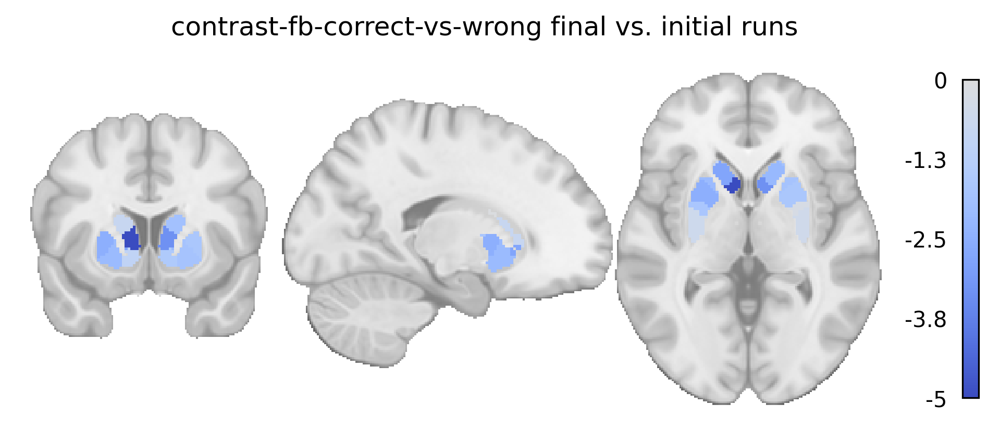

In [47]:
from nilearn.image import new_img_like
from nilearn import plotting

group = 'non-Mandarin'

mask_path_list = []
for rx, region in enumerate(region_list):
    print(region)
    
    sub_id = subjects_label[fx]
    mask_fpath = glob(masks_dir + f'/{sub_id}/space-MNI152NLin2009cAsym/masks-*/*{region}*.nii.gz')[0]

    # create list of mask file paths
    mask_path_list.append(mask_fpath)

roi_stat_data_list = []
for rx, rpath in enumerate(mask_path_list):
    roi_img = nib.load(rpath)
    roi_data = roi_img.get_fdata()
    
    roi_stat = t_stats[rx]
    roi_stat_data = roi_data * roi_stat
    
    roi_stat_data_list.append(roi_stat_data)

# add maps together and make nifti img
roi_stat_map_data = sum(roi_stat_data_list)
roi_stat_map_img = new_img_like(roi_img, roi_stat_map_data)

title = f'contrast-{contrast_label} final vs. initial runs'
fig, ax = plt.subplots(figsize=(8,3), dpi=300)
plotting.plot_stat_map(roi_stat_map_img,
                       bg_img=mni152_template,
                       black_bg=False,
                       cmap='coolwarm',
                       annotate=False, draw_cross=False,
                       #cut_coords=[-10, 14, 2],
                       axes=ax)
fig.suptitle(title);

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:758: UserWarning:





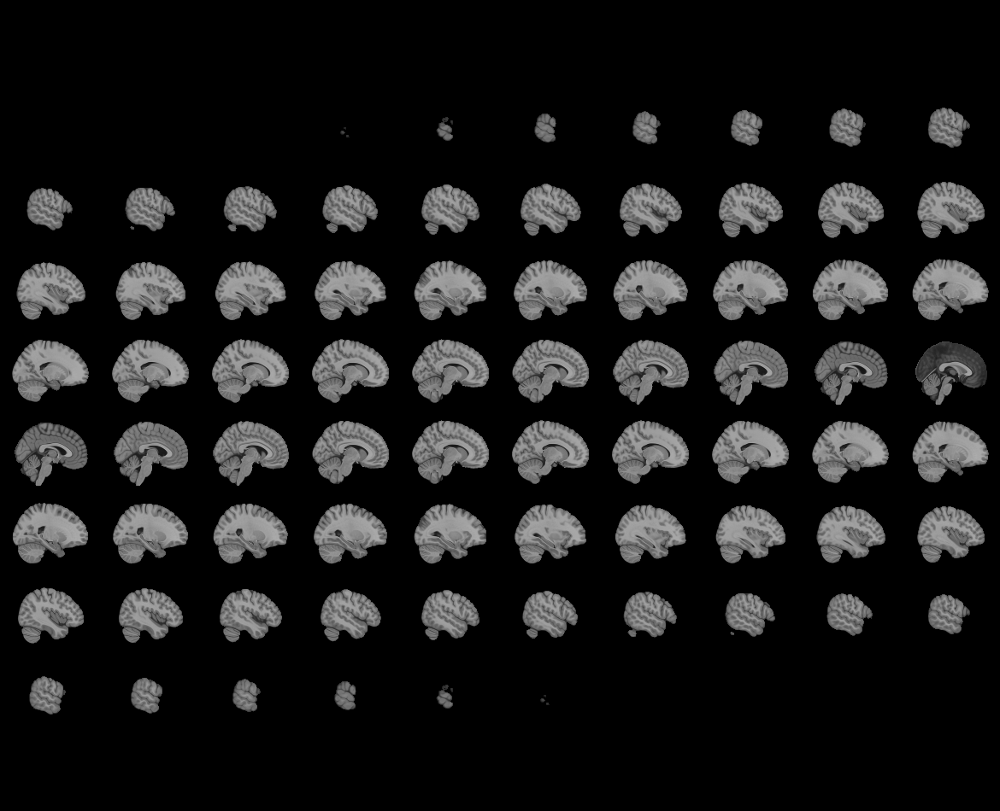
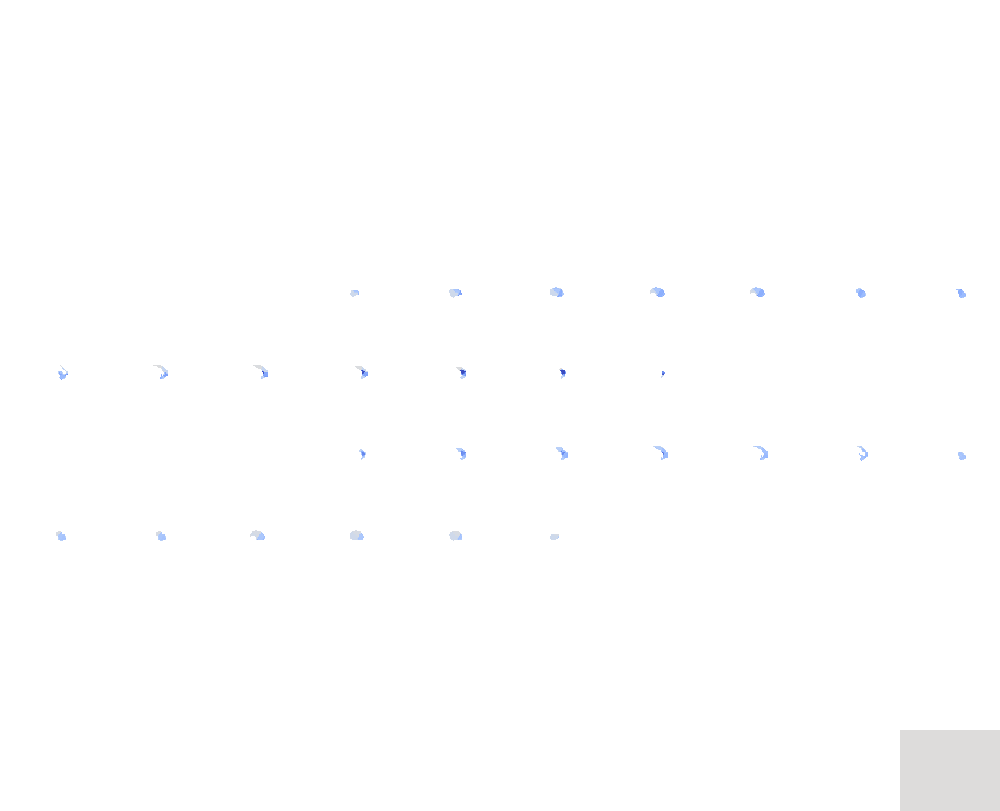

In [51]:
plotting.view_img(roi_stat_map_img, cmap='coolwarm')

### 3D plots

#### TO DO: combine files

In [55]:
# Combine early-minus-late into single files that can be read in

roi_stat_data_list = []
roi_stat_img_list = []
for rx, rpath in enumerate(mask_path_list):
    roi_img = nib.load(rpath)
    roi_data = roi_img.get_fdata()
    
    roi_stat = t_stats[rx]
    roi_stat_data = roi_data * roi_stat
    
    roi_stat_data_list.append(roi_stat_data)
    
    # make image for each t-stat
    roi_stat_img = new_img_like(roi_img, roi_stat_data)
    roi_stat_img_list.append(roi_stat_img)

# add maps together and make nifti img
roi_stat_map_data = sum(roi_stat_data_list)
roi_stat_map_img = new_img_like(roi_img, roi_stat_map_data)


In [ ]:
import numpy as np
import nibabel as nib
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from matplotlib import cm
from skimage import measure
from scipy.ndimage import gaussian_filter

# Load NIfTI files into a list
nifti_files = mask_path_list

# Define a colormap
colormap = cm.get_cmap('Blues_r')

# Define the list of values for color plotting
color_values = t_stats  # Adjust these values as needed

# Create a list to hold the data for each segmentation
segmentations = []

# Loop through each NIfTI file and extract segmentation data
for nifti_file in nifti_files:
    nifti_data = nib.load(nifti_file)
    segmentation = nifti_data.get_fdata()
    segmentations.append(segmentation)

# Combine all segmentations into a single binary mask
combined_segmentation = np.any(segmentations, axis=0)

# Upsample the voxel data to a higher resolution grid
upsampled_segmentation = np.repeat(np.repeat(np.repeat(combined_segmentation, 2, axis=0), 2, axis=1), 2, axis=2)

# Smooth the upsampled voxel data with a Gaussian filter
smoothed_segmentation = gaussian_filter(upsampled_segmentation, sigma=1)

# Extract the surface mesh of the smoothed segmented region with adjusted level
vertices, faces, _, _ = measure.marching_cubes(smoothed_segmentation, level=smoothed_segmentation.mean())

# Translate vertices closer to the origin
center = vertices.mean(axis=0)
vertices -= center

# Create a subplot for the 3D plot with a larger size
fig = make_subplots(rows=1, cols=1, specs=[[{'type': 'mesh3d'}]], print_grid=False)

# Loop through each segmentation and add its surface plot to the subplot
for i, segmentation in enumerate(segmentations):
    # Upsample the voxel data to a higher resolution grid
    upsampled_segmentation = np.repeat(np.repeat(np.repeat(segmentation, 2, axis=0), 2, axis=1), 2, axis=2)
    
    # Smooth the upsampled voxel data with a Gaussian filter
    smoothed_segmentation = gaussian_filter(upsampled_segmentation, sigma=1)
    
    # Extract the surface mesh of the smoothed segmented region with adjusted level
    vertices, faces, _, _ = measure.marching_cubes(smoothed_segmentation, level=smoothed_segmentation.mean())
    
    vertices -= center
    
    # Map the color value to the colormap
    colormap_value = (color_values[i] - min(color_values)) / (max(color_values) - min(color_values))
    color = colormap(colormap_value)
    
    # Add the surface plot to the subplot
    fig.add_trace(go.Mesh3d(
        x=vertices[:, 0],
        y=vertices[:, 1],
        z=vertices[:, 2],
        i=faces[:, 0],
        j=faces[:, 1],
        k=faces[:, 2],
        color=f'rgb({int(color[0]*255)}, {int(color[1]*255)}, {int(color[2]*255)})',
        opacity=1,
        name= region_list[i] # f'Segmentation {i+1}'
    ))

# Set starting camera angle
camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=-1.25, y=1.25, z=1.25)
)

# Update layout for the 3D plot to set a larger size and transparent background
fig.update_layout(
    scene=dict(
        xaxis=dict(title='X', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        yaxis=dict(title='Y', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        zaxis=dict(title='Z', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        bgcolor='rgba(0,0,0,0)',  # Set background color to transparent
        camera=camera  # Set starting camera angle
    ),
    title=f'Non-Mandarin-speaking participants contrast-{contrast_label} early vs. late stage',
    width=800,  # Set width of the plot
    height=600,  # Set height of the plot
)


'''
# Add XYZ axis legends closer to the surfaces
axis_length = 10  # Adjust the length of the axis lines
text_offset = 5  # Adjust the offset for text position

fig.add_trace(go.Scatter3d(
    x=[0, axis_length],
    y=[0, 0],
    z=[0, 0],
    mode='lines+text',
    line=dict(color='black', width=4),
    text=['X', ''],
    textposition='middle center',
    showlegend=False
))

fig.add_trace(go.Scatter3d(
    x=[0, 0],
    y=[0, axis_length],
    z=[0, 0],
    mode='lines+text',
    line=dict(color='black', width=4),
    text=['', 'Y'],
    textposition='middle center',
    showlegend=False
))

fig.add_trace(go.Scatter3d(
    x=[0, 0],
    y=[0, 0],
    z=[0, axis_length],
    mode='lines+text',
    line=dict(color='black', width=4),
    text=['', '', 'Z'],
    textposition='middle center',
    showlegend=False
))
'''

# Show the interactive plot
fig.show()

# Save the interactive plot as an SVG file
#fig.write_image('out-figure_group-nman_contrast-fb-early-late_surface.svg')

#### Add colorbar

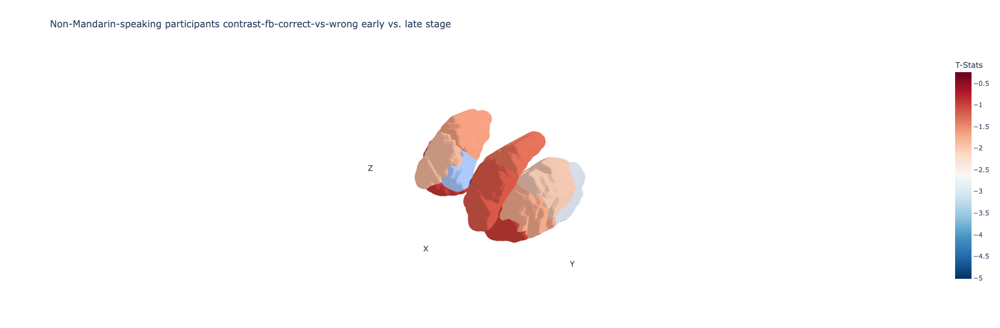

In [83]:
import numpy as np
import nibabel as nib
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from matplotlib import cm
from skimage import measure
from scipy.ndimage import gaussian_filter

# Load NIfTI files into a list
nifti_files = mask_path_list

# Define a colormap
colormap = cm.get_cmap('coolwarm')

# Define the list of values for color plotting
color_values = t_stats  # Adjust these values as needed

# Create a list to hold the data for each segmentation
segmentations = []

# Loop through each NIfTI file and extract segmentation data
for nifti_file in nifti_files:
    nifti_data = nib.load(nifti_file)
    segmentation = nifti_data.get_fdata()
    segmentations.append(segmentation)

# Combine all segmentations into a single binary mask
combined_segmentation = np.any(segmentations, axis=0)

# Upsample the voxel data to a higher resolution grid
upsampled_segmentation = np.repeat(np.repeat(np.repeat(combined_segmentation, 2, axis=0), 2, axis=1), 2, axis=2)

# Smooth the upsampled voxel data with a Gaussian filter
smoothed_segmentation = gaussian_filter(upsampled_segmentation, sigma=1)

# Extract the surface mesh of the smoothed segmented region with adjusted level
vertices, faces, _, _ = measure.marching_cubes(smoothed_segmentation, level=smoothed_segmentation.mean())

# Translate vertices closer to the origin
center = vertices.mean(axis=0)
vertices -= center

# Create a subplot for the 3D plot with a larger size
fig = make_subplots(rows=1, cols=1, specs=[[{'type': 'mesh3d'}]], print_grid=False)

# Loop through each segmentation and add its surface plot to the subplot
for i, segmentation in enumerate(segmentations):
    # Upsample the voxel data to a higher resolution grid
    upsampled_segmentation = np.repeat(np.repeat(np.repeat(segmentation, 2, axis=0), 2, axis=1), 2, axis=2)
    
    # Smooth the upsampled voxel data with a Gaussian filter
    smoothed_segmentation = gaussian_filter(upsampled_segmentation, sigma=1)
    
    # Extract the surface mesh of the smoothed segmented region with adjusted level
    vertices, faces, _, _ = measure.marching_cubes(smoothed_segmentation, level=smoothed_segmentation.mean())
    
    vertices -= center
    
    # Map the color value to the colormap
    colormap_value = (color_values[i] - min(color_values)) / (max(color_values) - min(color_values))
    color = colormap(colormap_value)
    
    # Add the surface plot to the subplot
    fig.add_trace(go.Mesh3d(
        x=vertices[:, 0],
        y=vertices[:, 1],
        z=vertices[:, 2],
        i=faces[:, 0],
        j=faces[:, 1],
        k=faces[:, 2],
        color=f'rgb({int(color[0]*255)}, {int(color[1]*255)}, {int(color[2]*255)})',
        opacity=1,
        name= region_list[i] # f'Segmentation {i+1}'
    ))

# Set starting camera angle
camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=-1.25, y=1.25, z=1.25)
)

# Create a color bar trace
color_bar_trace = go.Scatter3d(
    x=[0],
    y=[0],
    z=[0],
    mode='markers',
    marker=dict(
        color=color_values,
        colorscale='RdBu_r',
        size=0.1,
        colorbar=dict(
            title="T-Stats"
        )
    ),
    hoverinfo='none'
)

# Update layout for the 3D plot to set a larger size and transparent background
fig.update_layout(
    scene=dict(
        xaxis=dict(title='X', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        yaxis=dict(title='Y', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        zaxis=dict(title='Z', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        bgcolor='rgba(0,0,0,0)',  # Set background color to transparent
        camera=camera  # Set starting camera angle
    ),
    title=f'Non-Mandarin-speaking participants contrast-{contrast_label} early vs. late stage',
    width=800,  # Set width of the plot
    height=600,  # Set height of the plot
)

# Add the color bar trace to the figure
fig.add_trace(color_bar_trace)

# Show the interactive plot
fig.show()


# ARCHIVE

# Early vs. late runs

In [34]:
# get the beta map for the contrast of interest for each subject
l1_fnames_firsthalf = [sorted(glob(l1_dir+'/%s_space-%s/grouped_runs/firsthalf/*%s_map-beta.nii.gz'%(sub_id, space_label, contrast_label)))[0] for sub_id in sub_list_nman]
l1_fnames_secondhalf = [sorted(glob(l1_dir+'/%s_space-%s/grouped_runs/secondhalf/*%s_map-beta.nii.gz'%(sub_id, space_label, contrast_label)))[0] for sub_id in sub_list_nman]

#l1_fnames_mand = [sorted(glob(l1_dir+'/%s_space-%s/grouped_runs/*%s_map-beta.nii.gz'%(sub_id, space_label, contrast_label)))[0] for sub_id in sub_list_mand]
#l1_fnames_nman = [sorted(glob(l1_dir+'/%s_space-%s/grouped_runs/*%s_map-beta.nii.gz'%(sub_id, space_label, contrast_label)))[0] for sub_id in sub_list_nman]

In [22]:
l1_fnames_firsthalf

['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT02_space-MNI152NLin2009cAsym/grouped_runs/firsthalf/sub-FLT02_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-fb-correct-vs-wrong_map-beta.nii.gz',
 '/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT04_space-MNI152NLin2009cAsym/grouped_runs/firsthalf/sub-FLT04_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-fb-correct-vs-wrong_map-beta.nii.gz',
 '/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT06_space-MNI152NLin2009cAsym/grouped_runs/firsthalf/sub-FLT06_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-fb-correct-vs-wrong_map-beta.nii.gz',
 '/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT09_space-MNI152NLin2009cAsym/grouped_runs/firsthalf/sub-FLT09_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-fb-correct

## Mask stat maps

In [23]:
roi_firsthalf_mean_dict = {}
roi_secondhalf_mean_dict = {}
for rx, region in enumerate(region_list):
    print(region)
    
    roi_firsthalf_mean_list = []
    for fx, stat_fpath in enumerate(l1_fnames_firsthalf):
        sub_id = subjects_label[fx]
        mask_fpath = glob(masks_dir + f'/{sub_id}/space-MNI152NLin2009cAsym/masks-*/*{region}*.nii.gz')[0]
        
        masked_data = apply_mask(stat_fpath, mask_fpath)
        roi_mean_sub = masked_data.mean()
        
        roi_firsthalf_mean_list.append(roi_mean_sub)
        
    roi_firsthalf_mean_dict[region] = roi_firsthalf_mean_list
    
    roi_secondhalf_mean_list = []
    for fx, stat_fpath in enumerate(l1_fnames_secondhalf):
        sub_id = subjects_label[fx]
        mask_fpath = glob(masks_dir + f'/{sub_id}/space-MNI152NLin2009cAsym/masks-*/*{region}*.nii.gz')[0]
        
        masked_data = apply_mask(stat_fpath, mask_fpath)
        roi_mean_sub = masked_data.mean()
        
        roi_secondhalf_mean_list.append(roi_mean_sub)
        
    roi_secondhalf_mean_dict[region] = roi_secondhalf_mean_list

CAU-DA-lh
CAU-VA-lh
pCAU-lh
PUT-DA-lh
PUT-DP-lh
PUT-VA-lh
PUT-VP-lh
aGP-lh
pGP-lh
NAc-core-lh
NAc-shell-lh
CAU-DA-rh
CAU-VA-rh
pCAU-rh
PUT-DA-rh
PUT-DP-rh
PUT-VA-rh
PUT-VP-rh
aGP-rh
pGP-rh
NAc-core-rh
NAc-shell-rh


In [24]:
roi_firsthalf_df = pd.DataFrame.from_dict(roi_firsthalf_mean_dict)
roi_secondhalf_df = pd.DataFrame.from_dict(roi_secondhalf_mean_dict)


roi_firsthalf_df['participant_id'] = nman_df.participant_id
roi_firsthalf_df['participant_group'] = nman_df.group
roi_secondhalf_df['participant_id'] = nman_df.participant_id
roi_secondhalf_df['participant_group'] = nman_df.group

In [25]:
roi_firsthalf_df

,CAU-DA-lh,CAU-VA-lh,pCAU-lh,PUT-DA-lh,PUT-DP-lh,PUT-VA-lh,PUT-VP-lh,aGP-lh,pGP-lh,NAc-core-lh,...,PUT-DA-rh,PUT-DP-rh,PUT-VA-rh,PUT-VP-rh,aGP-rh,pGP-rh,NAc-core-rh,NAc-shell-rh,participant_id,participant_group
0,0.388666,0.727526,0.197428,0.484773,0.976219,1.157480,0.764472,-0.256605,-0.297060,0.076296,...,0.191935,0.583774,0.742082,0.041198,-1.158139,0.562395,0.952053,1.045824,sub-FLT02,non-Mandarin
1,1.906977,1.987375,-0.239466,0.653546,0.629441,1.399925,0.660832,0.142628,-0.075272,0.997953,...,0.460591,0.404958,1.569946,1.387648,-0.257370,-0.623503,1.340958,2.071275,sub-FLT03,Mandarin
2,-0.319096,0.262850,0.999900,-0.061366,-0.032751,0.243217,0.309725,0.010260,0.277956,0.197993,...,-0.158318,-0.671863,0.151844,0.242793,-0.140509,0.540013,0.360038,0.748664,sub-FLT04,non-Mandarin
3,0.510752,0.379236,0.918594,0.094653,-0.185539,0.415729,0.438368,0.315840,0.342069,0.311824,...,0.099852,0.055209,1.106292,0.340807,0.081973,-0.282975,0.543923,0.510768,sub-FLT06,non-Mandarin
4,0.571229,2.163502,1.856360,1.598178,0.960838,1.095536,0.183604,-0.148217,0.338556,1.092744,...,0.372954,0.135843,1.161562,-0.211015,-0.651177,0.125363,1.059783,0.361132,sub-FLT09,non-Mandarin
5,0.588251,1.271245,1.281899,1.229407,0.730960,0.701117,0.870442,0.626064,-0.262251,0.198489,...,0.234491,1.122215,0.552794,1.786533,0.457595,0.838720,0.223511,-0.283703,sub-FLT11,non-Mandarin
6,-0.063442,0.356387,-0.131134,0.478468,-0.091225,1.065780,0.274150,0.305081,-0.172133,0.467732,...,0.381372,0.062006,1.100361,0.370660,0.040601,0.133001,1.064228,1.272924,sub-FLT12,non-Mandarin
7,-0.300627,-2.219945,-0.444124,0.644677,0.278095,0.418776,0.246907,0.035502,0.085096,-0.565848,...,0.994632,0.634175,0.736474,0.954500,0.143273,0.381200,-0.561068,0.028716,sub-FLT13,non-Mandarin
8,-1.123427,-0.181947,-1.369259,0.276184,0.201480,0.402624,1.000871,-0.138184,0.156129,-0.154971,...,0.222259,0.682122,-0.014805,0.808513,-0.019877,0.613958,-0.077774,0.480613,sub-FLT14,non-Mandarin
9,0.267781,0.605670,0.106152,0.086613,-0.211615,0.779931,-0.016772,0.087667,0.089919,0.980259,...,-0.258555,-0.515675,0.752778,-0.352384,-0.109848,-0.160804,1.106646,0.943111,sub-FLT17,Mandarin


In [26]:
roi_secondhalf_df

,CAU-DA-lh,CAU-VA-lh,pCAU-lh,PUT-DA-lh,PUT-DP-lh,PUT-VA-lh,PUT-VP-lh,aGP-lh,pGP-lh,NAc-core-lh,...,PUT-DA-rh,PUT-DP-rh,PUT-VA-rh,PUT-VP-rh,aGP-rh,pGP-rh,NAc-core-rh,NAc-shell-rh,participant_id,participant_group
0,-0.427462,-2.036729,-2.208120,0.875682,0.755310,2.281610,-1.632930,0.495910,0.053279,3.552275,...,1.480513,1.578781,0.122957,0.439006,0.155264,-0.873352,0.043628,2.031701,sub-FLT02,non-Mandarin
1,0.672924,0.257988,-0.188410,0.376366,0.495255,0.979089,0.722077,0.106393,-0.218082,0.712574,...,0.903290,0.836107,1.249195,0.846484,-0.199132,-0.034398,1.062918,0.787973,sub-FLT03,Mandarin
2,0.806045,-0.742673,0.152982,0.427624,0.183255,1.074512,0.538168,-0.772240,0.195200,0.734517,...,0.176575,0.531955,0.342895,1.232020,-0.197557,0.492803,0.103698,0.019809,sub-FLT04,non-Mandarin
3,0.848012,0.244054,1.016347,0.747791,-0.092201,0.746448,-0.369551,-0.069198,-0.230534,0.788035,...,0.531390,0.565610,0.480627,-0.507011,0.117262,-0.867988,0.395982,0.269194,sub-FLT06,non-Mandarin
4,0.384750,1.039647,1.505115,0.610990,1.066580,2.269364,1.689381,1.149314,1.721254,1.100960,...,1.155210,0.266258,2.852539,0.665738,2.221845,1.663817,-0.540492,0.448273,sub-FLT09,non-Mandarin
5,-0.698605,-1.971117,-0.742149,0.133107,-0.297907,-0.006773,-0.276072,-0.904736,-0.651108,-0.805804,...,0.155474,-0.230910,0.385797,-0.548469,-0.918118,-0.143371,-0.371502,-0.999563,sub-FLT11,non-Mandarin
6,0.645418,-1.017931,0.015834,0.010370,-0.394710,0.729734,-0.419266,0.159029,-0.140703,0.044119,...,-0.192037,-0.993056,1.288874,-0.400376,0.026087,0.090047,0.396554,0.735844,sub-FLT12,non-Mandarin
7,0.536274,-3.382968,0.371882,-0.031383,-1.128372,1.185919,-1.284675,0.390941,-1.214572,-1.099082,...,0.449252,-0.774372,1.047845,-0.640250,0.667833,-0.241387,-0.049572,-1.014716,sub-FLT13,non-Mandarin
8,0.440012,1.198574,-1.368170,1.889316,1.225647,2.088046,1.173778,0.113210,0.397881,1.041880,...,1.374573,0.515718,1.496230,1.403775,0.005277,0.442851,0.771413,0.888376,sub-FLT14,non-Mandarin
9,-0.322740,-0.253627,-1.502578,-0.794027,-1.134240,0.195063,-0.628624,0.029104,-0.167557,0.968223,...,-0.343189,-1.478750,0.533469,-0.814686,0.003459,-0.368977,1.036482,0.651931,sub-FLT17,Mandarin


In [27]:
roi_firsthalf_df_long = roi_firsthalf_df.melt(id_vars=["participant_id", "participant_group", ], 
                                              var_name="region", value_name="beta")
roi_firsthalf_df_long['data_split'] = 'first_half'

roi_secondhalf_df_long = roi_secondhalf_df.melt(id_vars=["participant_id", "participant_group"], 
                                               var_name="region", value_name="beta")
roi_secondhalf_df_long['data_split'] = 'second_half'

if network_name == 'auditory':
    roi_firsthalf_df_long['hemisphere'] = roi_firsthalf_df_long.region.str[0]
    roi_firsthalf_df_long['region'] = roi_firsthalf_df_long.region.str[2:]
    roi_secondhalf_df_long['hemisphere'] = roi_secondhalf_df_long.region.str[0]
    roi_secondhalf_df_long['region'] = roi_secondhalf_df_long.region.str[2:]
elif network_name == 'tian_subcortical_S3':
    roi_firsthalf_df_long['hemisphere'] = roi_firsthalf_df_long.region.str[-2:]
    roi_firsthalf_df_long['region'] = roi_firsthalf_df_long.region.str[:-3]
    roi_secondhalf_df_long['hemisphere'] = roi_secondhalf_df_long.region.str[-2:]
    roi_secondhalf_df_long['region'] = roi_secondhalf_df_long.region.str[:-3]

In [28]:
roi_df_long = pd.concat([roi_firsthalf_df_long, roi_secondhalf_df_long],)


In [29]:
roi_df_long

,participant_id,participant_group,region,beta,data_split,hemisphere
0,sub-FLT02,non-Mandarin,CAU-DA,0.388666,first_half,lh
1,sub-FLT03,Mandarin,CAU-DA,1.906977,first_half,lh
2,sub-FLT04,non-Mandarin,CAU-DA,-0.319096,first_half,lh
3,sub-FLT06,non-Mandarin,CAU-DA,0.510752,first_half,lh
4,sub-FLT09,non-Mandarin,CAU-DA,0.571229,first_half,lh
...,...,...,...,...,...,...
259,sub-FLT13,non-Mandarin,NAc-shell,-1.014716,second_half,rh
260,sub-FLT14,non-Mandarin,NAc-shell,0.888376,second_half,rh
261,sub-FLT17,Mandarin,NAc-shell,0.651931,second_half,rh
262,sub-FLT20,non-Mandarin,NAc-shell,1.430760,second_half,rh


### Compare halfs

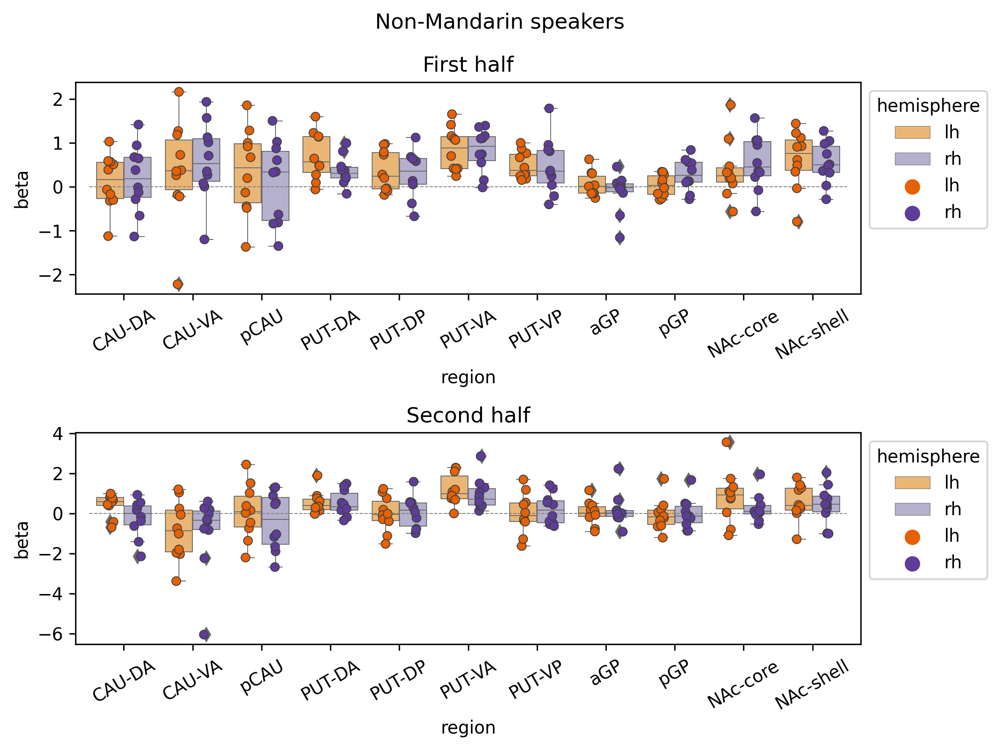

In [61]:
fig, ax = plt.subplots(2, 1, figsize=(8,6), dpi=300)
fig.suptitle('Non-Mandarin speakers')

sns.boxplot(data=roi_firsthalf_df_long.where(roi_firsthalf_df_long.participant_group=='non-Mandarin'), 
              x='region', y='beta', 
              hue='hemisphere',
              palette=['#fdb863','#b2abd2'],
              linewidth=0.5,
              ax=ax[0]);
sns.stripplot(data=roi_firsthalf_df_long.where(roi_firsthalf_df_long.participant_group=='non-Mandarin'), 
              x='region', y='beta', 
              hue='hemisphere',
              palette=['#e66101','#5e3c99'],
              dodge=True,
              linewidth=0.5,
              ax=ax[0]);
xmin, xmax = ax[0].get_xlim()
ax[0].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=30, ha='center')
sns.move_legend(ax[0], "upper left", bbox_to_anchor=(1, 1))
ax[0].set_title('First half');

sns.boxplot(data=roi_secondhalf_df_long.where(roi_secondhalf_df_long.participant_group=='non-Mandarin'), 
              x='region', y='beta', 
              hue='hemisphere',
              palette=['#fdb863','#b2abd2'],
              linewidth=0.5,
              ax=ax[1]);
sns.stripplot(data=roi_secondhalf_df_long.where(roi_secondhalf_df_long.participant_group=='non-Mandarin'), 
              x='region', y='beta', 
              hue='hemisphere',
              palette=['#e66101','#5e3c99'],
              dodge=True,
              linewidth=0.5,
              ax=ax[1]);
xmin, xmax = ax[1].get_xlim()
ax[1].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation=30, ha='center')
sns.move_legend(ax[1], "upper left", bbox_to_anchor=(1, 1))
ax[1].set_title('Second half');

fig.tight_layout()


### Statistics

#### Within-group differences between halves

In [58]:
p_vals = []
t_stats = []
print('Non-Mandarin, first half vs. second half')
for roi in region_list:
    data1 = roi_firsthalf_df.where(roi_firsthalf_df.participant_group=='non-Mandarin').dropna()[roi]
    data2 = roi_secondhalf_df.where(roi_secondhalf_df.participant_group=='non-Mandarin').dropna()[roi]
    res = stats.ttest_rel(data1, data2)
    #print(f'p = {res.pvalue:.04f} t = {res.statistic:.02f} region = {roi}')
    p_vals.append(res.pvalue)
    t_stats.append(res.statistic)
    
p_vals_adj = stats.false_discovery_control(p_vals)

print('\nFDR-adjusted statistics')
for rx, roi in enumerate(region_list):
    print(f't = {t_stats[rx]:.02f} p = {p_vals_adj[rx]:.04f} region = {roi}')

Non-Mandarin, first half vs. second half

FDR-adjusted statistics
t = -1.08 p = 0.6439 region = CAU-DA-lh
t = 3.04 p = 0.3071 region = CAU-VA-lh
t = 0.58 p = 0.7271 region = pCAU-lh
t = 0.61 p = 0.7271 region = PUT-DA-lh
t = 1.52 p = 0.6439 region = PUT-DP-lh
t = -1.16 p = 0.6439 region = PUT-VA-lh
t = 1.44 p = 0.6439 region = PUT-VP-lh
t = 0.13 p = 0.9021 region = aGP-lh
t = 0.50 p = 0.7282 region = pGP-lh
t = -1.15 p = 0.6439 region = NAc-core-lh
t = 0.19 p = 0.8919 region = NAc-shell-lh
t = 1.09 p = 0.6439 region = CAU-DA-rh
t = 2.51 p = 0.3677 region = CAU-VA-rh
t = 1.05 p = 0.6439 region = pCAU-rh
t = -0.55 p = 0.7271 region = PUT-DA-rh
t = 0.74 p = 0.7271 region = PUT-DP-rh
t = -0.41 p = 0.7610 region = PUT-VA-rh
t = 0.78 p = 0.7271 region = PUT-VP-rh
t = -0.89 p = 0.7234 region = aGP-rh
t = 1.19 p = 0.6439 region = pGP-rh
t = 1.16 p = 0.6439 region = NAc-core-rh
t = 0.59 p = 0.7271 region = NAc-shell-rh
